In [34]:
# The I/O module is used for importing the image
from skimage import data
import numpy as np
import matplotlib.pyplot as plt
from skimage import io
from skimage import segmentation as seg
from skimage import filters, draw, color
import numpy as np
import matplotlib.pyplot as plt

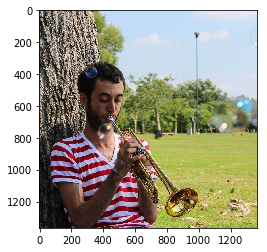

In [16]:
image = io.imread('billy.jpg')
plt.imshow(image);

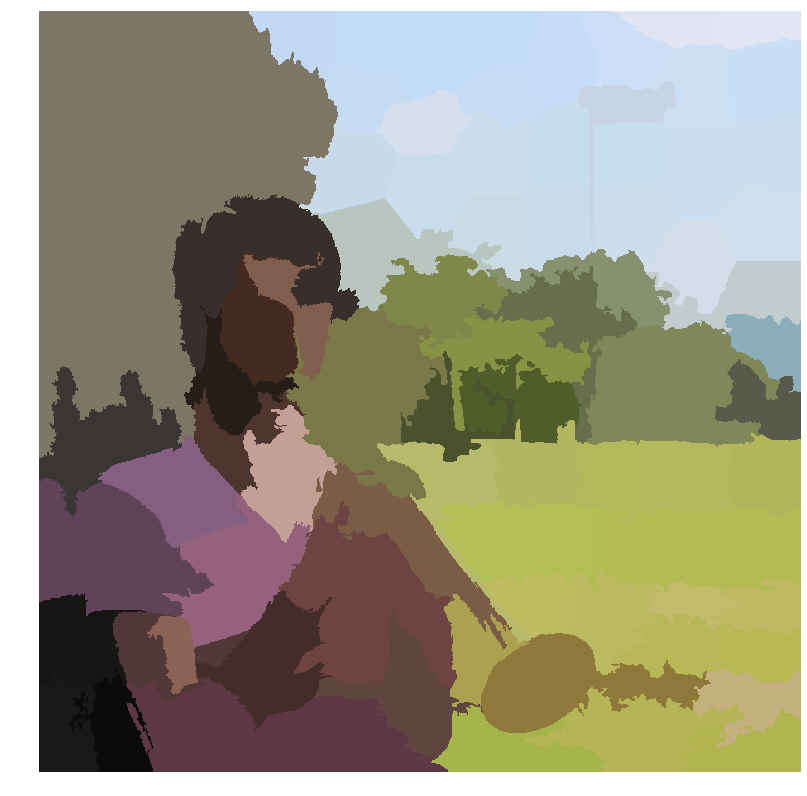

In [6]:
image_slic = seg.slic(image,n_segments=155)
image_show(color.label2rgb(image_slic, image, kind='avg'));

In [20]:
from skimage import filters

edges = filters.canny(image, sigma=3,
                     low_threshold=10,
                     high_threshold=80)

ax4.imshow(edges, cmap=plt.cm.gray)
ax4.set_title('Edges', fontsize=24)
ax4.axis('off')

ModuleNotFoundError: No module named 'skimage.filter'

In [31]:
import skimage
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.util import img_as_float

img = img_as_float(image[::2, ::2])
segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
o = skimage.segmentation.find_boundaries(img, segments_fz)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

Felzenszwalb number of segments: 1332
SLIC number of segments: 183
Quickshift number of segments: 3570


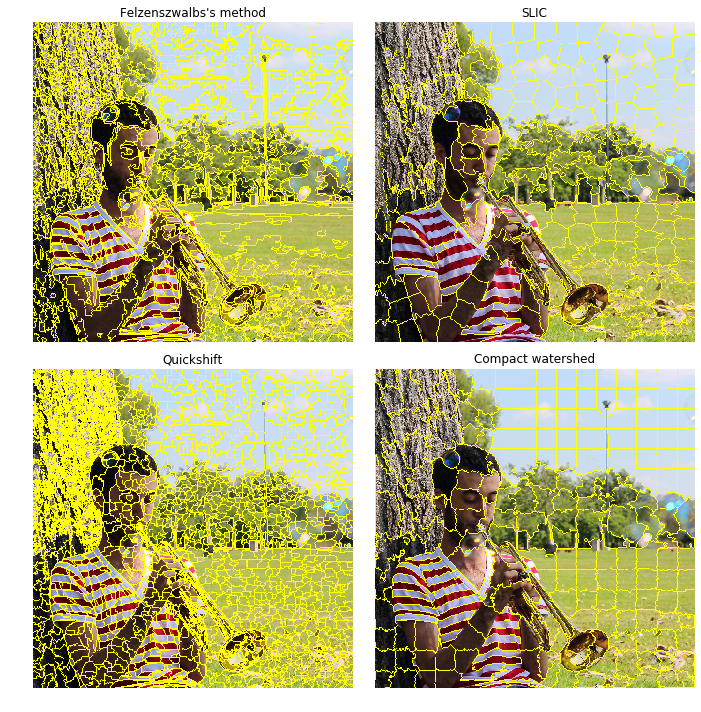

In [33]:
import matplotlib.pyplot as plt
import numpy as np

from skimage.data import astronaut
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float

img = img_as_float(image[::2, ::2])

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)
gradient = sobel(rgb2gray(img))
segments_watershed = watershed(gradient, markers=250, compactness=0.001)

print("Felzenszwalb number of segments: {}".format(len(np.unique(segments_fz))))
print('SLIC number of segments: {}'.format(len(np.unique(segments_slic))))
print('Quickshift number of segments: {}'.format(len(np.unique(segments_quick))))

fig, ax = plt.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_fz))
ax[0, 0].set_title("Felzenszwalbs's method")
ax[0, 1].imshow(mark_boundaries(img, segments_slic))
ax[0, 1].set_title('SLIC')
ax[1, 0].imshow(mark_boundaries(img, segments_quick))
ax[1, 0].set_title('Quickshift')
ax[1, 1].imshow(mark_boundaries(img, segments_watershed))
ax[1, 1].set_title('Compact watershed')

for a in ax.ravel():
    a.set_axis_off()

plt.tight_layout()
plt.show()

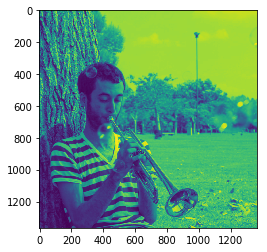

In [55]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import measure

from PIL import Image
from numpy import*

temp=asarray(Image.open('billy.jpg'))
for j in temp:
    new_temp = asarray([[i[0],i[1]] for i in j]) # new_temp gets the two first pixel values

gray = rgb2gray(temp)

gray_blur = skimage.filters.gaussian(gray)
plt.imshow(gray_blur)

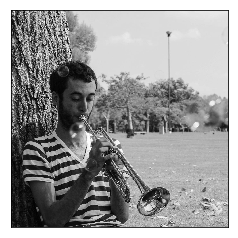

In [49]:

# Find contours at a constant value of 0.8
contours = measure.find_contours(gray, 10.0, fully_connected='high')

# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(gray, interpolation='nearest', cmap=plt.cm.gray)

for n, contour in enumerate(contours):
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

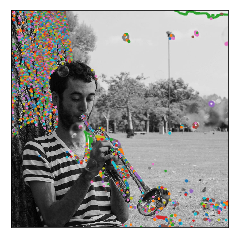

In [52]:

# Find contours at a constant value of 0.8
contours = measure.find_contours(gray, 0.9, fully_connected='high')

# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(gray, interpolation='nearest', cmap=plt.cm.gray)

for n, contour in enumerate(contours):
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

In [79]:
def contour_image(image, sigma, contour_parameter, level):
    # Find contours at a constant value of 0.8
    print("sigma: %s, param: %s" % (sigma, contour_parameter))
    
    gray_blur = skimage.filters.gaussian(gray, sigma=10.0)
    #plt.imshow(gray_blur)

    contours = measure.find_contours(gray_blur, 0.6, fully_connected=level)

    # Display the image and plot all contours found
    fig, ax = plt.subplots()
    ax.imshow(gray_blur, interpolation='nearest', cmap=plt.cm.gray)

    for n, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

    ax.axis('image')
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    print("_____________________")

sigma: 0.1, param: 0.0


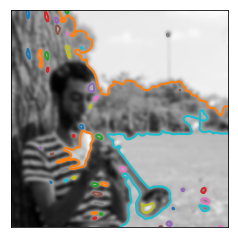

_____________________
sigma: 0.5, param: 0.0


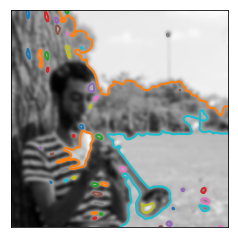

_____________________
sigma: 0.8, param: 0.0


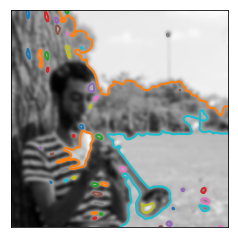

_____________________
sigma: 1.0, param: 0.0


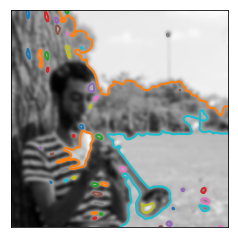

_____________________
sigma: 1.2, param: 0.0


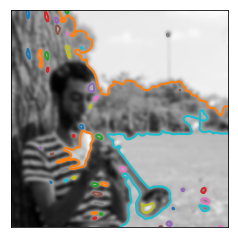

_____________________
sigma: 2.0, param: 0.0


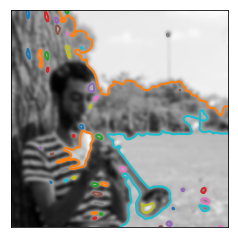

_____________________
sigma: 2.5, param: 0.0


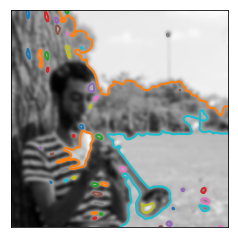

_____________________
sigma: 3.0, param: 0.0


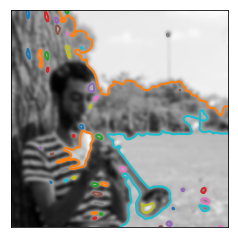

_____________________
sigma: 3.5, param: 0.0


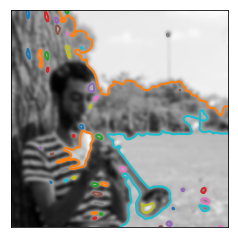

_____________________
sigma: 5.0, param: 0.0


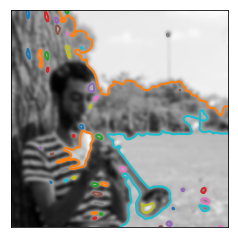

_____________________
sigma: 10.0, param: 0.0


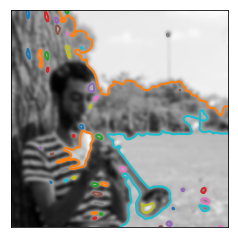

_____________________
sigma: 15.0, param: 0.0


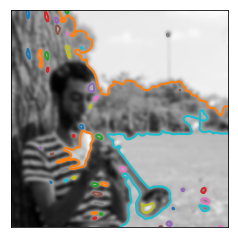

_____________________
sigma: 20.0, param: 0.0


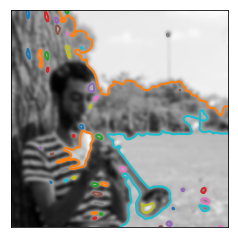

_____________________
sigma: 30.0, param: 0.0


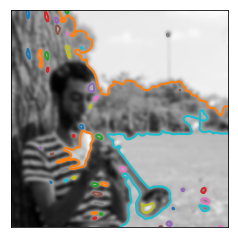

_____________________
sigma: 50.0, param: 0.0


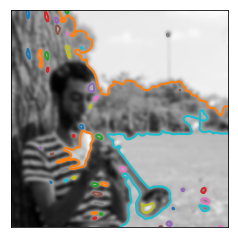

_____________________
sigma: 100.0, param: 0.0


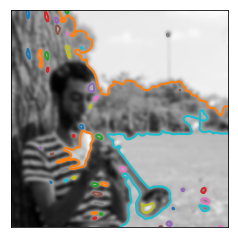

_____________________
sigma: 0.1, param: 0.1


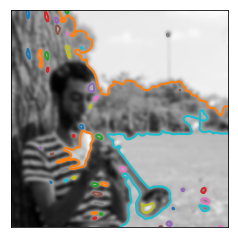

_____________________
sigma: 0.5, param: 0.1


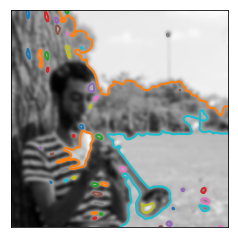

_____________________
sigma: 0.8, param: 0.1


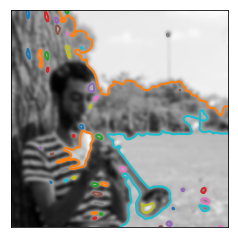

_____________________
sigma: 1.0, param: 0.1


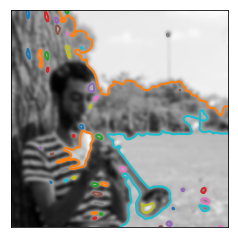

_____________________
sigma: 1.2, param: 0.1


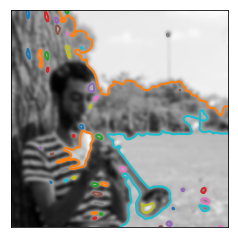

_____________________
sigma: 2.0, param: 0.1


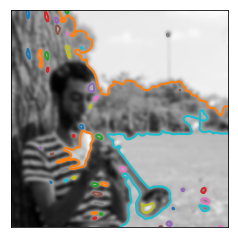

_____________________
sigma: 2.5, param: 0.1


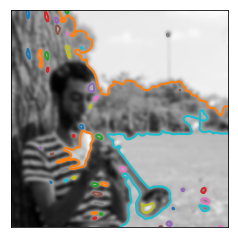

_____________________
sigma: 3.0, param: 0.1


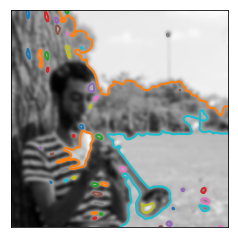

_____________________
sigma: 3.5, param: 0.1


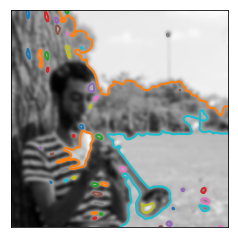

_____________________
sigma: 5.0, param: 0.1


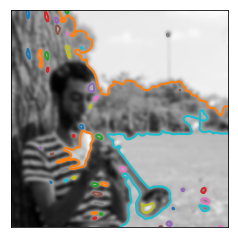

_____________________
sigma: 10.0, param: 0.1


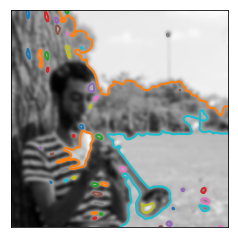

_____________________
sigma: 15.0, param: 0.1


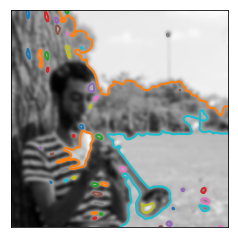

_____________________
sigma: 20.0, param: 0.1


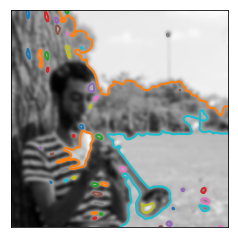

_____________________
sigma: 30.0, param: 0.1


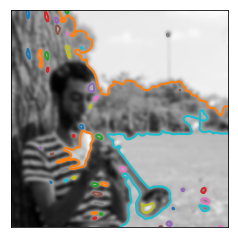

_____________________
sigma: 50.0, param: 0.1


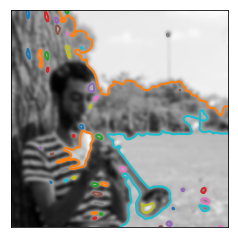

_____________________
sigma: 100.0, param: 0.1


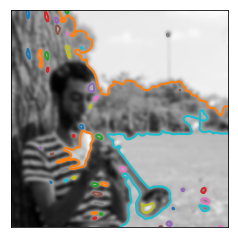

_____________________
sigma: 0.1, param: 0.2


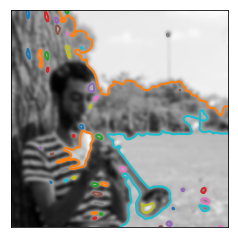

_____________________
sigma: 0.5, param: 0.2


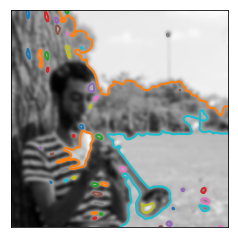

_____________________
sigma: 0.8, param: 0.2


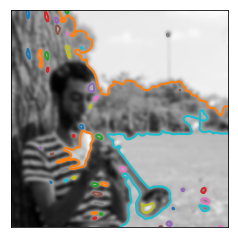

_____________________
sigma: 1.0, param: 0.2


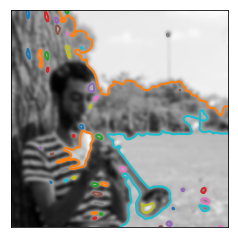

_____________________
sigma: 1.2, param: 0.2


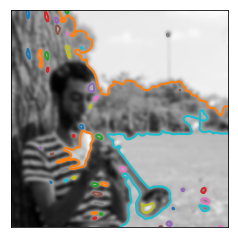

_____________________
sigma: 2.0, param: 0.2


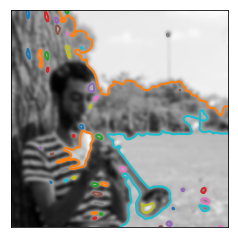

_____________________
sigma: 2.5, param: 0.2


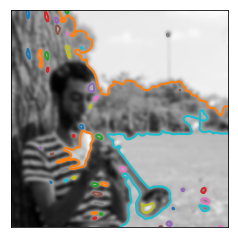

_____________________
sigma: 3.0, param: 0.2


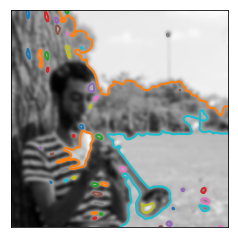

_____________________
sigma: 3.5, param: 0.2


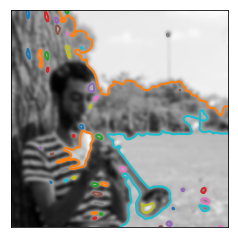

_____________________
sigma: 5.0, param: 0.2


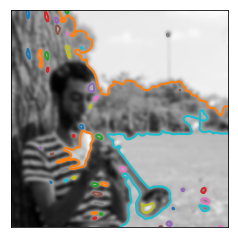

_____________________
sigma: 10.0, param: 0.2


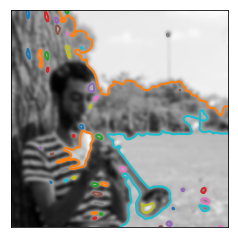

_____________________
sigma: 15.0, param: 0.2


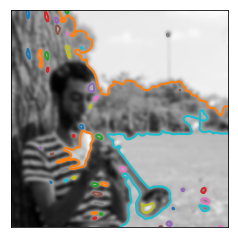

_____________________
sigma: 20.0, param: 0.2


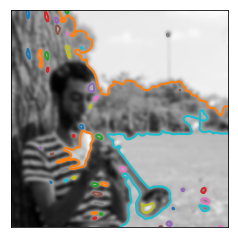

_____________________
sigma: 30.0, param: 0.2


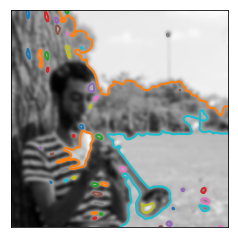

_____________________
sigma: 50.0, param: 0.2


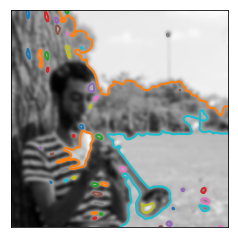

_____________________
sigma: 100.0, param: 0.2


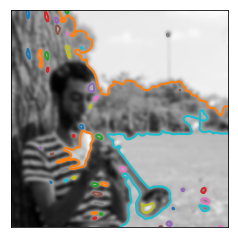

_____________________
sigma: 0.1, param: 0.3


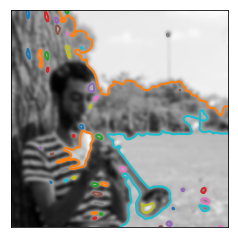

_____________________
sigma: 0.5, param: 0.3


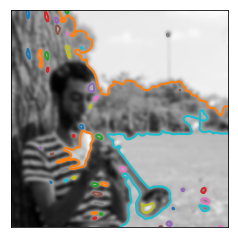

_____________________
sigma: 0.8, param: 0.3


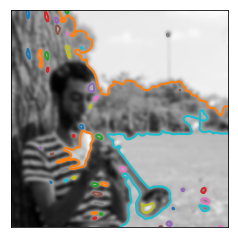

_____________________
sigma: 1.0, param: 0.3


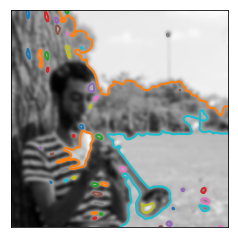

_____________________
sigma: 1.2, param: 0.3


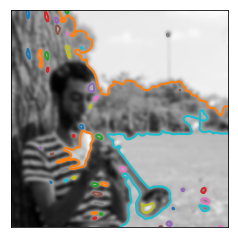

_____________________
sigma: 2.0, param: 0.3


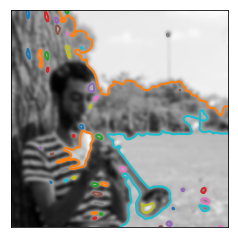

_____________________
sigma: 2.5, param: 0.3


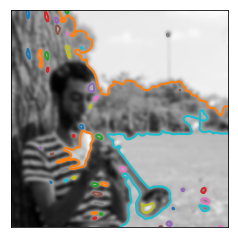

_____________________
sigma: 3.0, param: 0.3


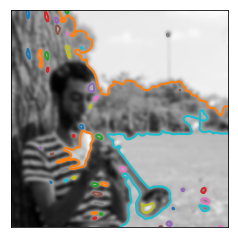

_____________________
sigma: 3.5, param: 0.3


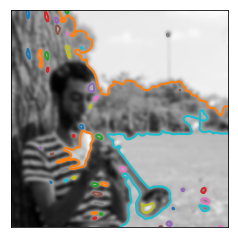

_____________________
sigma: 5.0, param: 0.3


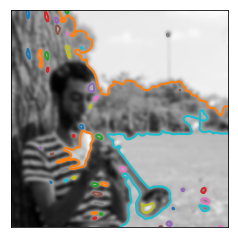

_____________________
sigma: 10.0, param: 0.3


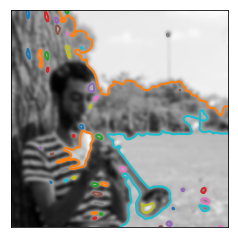

_____________________
sigma: 15.0, param: 0.3


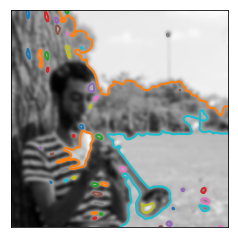

_____________________
sigma: 20.0, param: 0.3


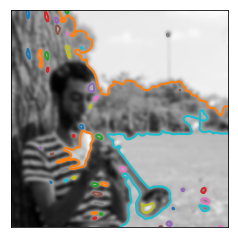

_____________________
sigma: 30.0, param: 0.3


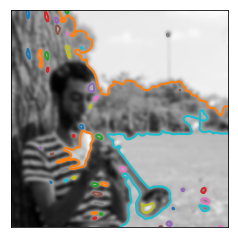

_____________________
sigma: 50.0, param: 0.3


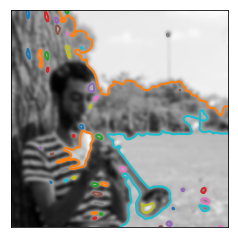

_____________________
sigma: 100.0, param: 0.3


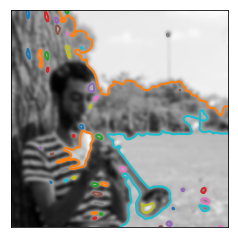

_____________________
sigma: 0.1, param: 0.5


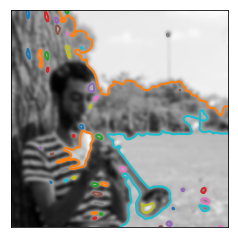

_____________________
sigma: 0.5, param: 0.5


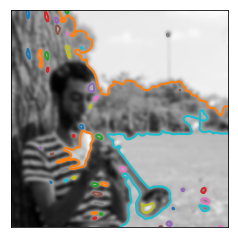

_____________________
sigma: 0.8, param: 0.5


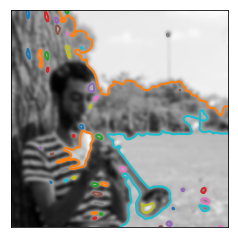

_____________________
sigma: 1.0, param: 0.5


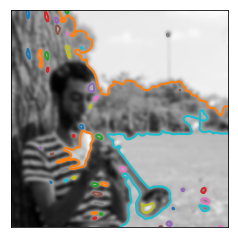

_____________________
sigma: 1.2, param: 0.5


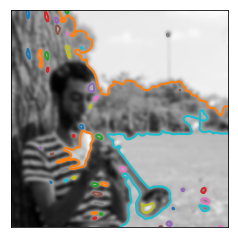

_____________________
sigma: 2.0, param: 0.5


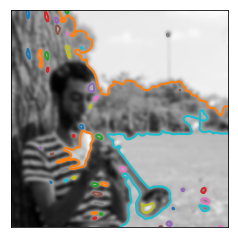

_____________________
sigma: 2.5, param: 0.5


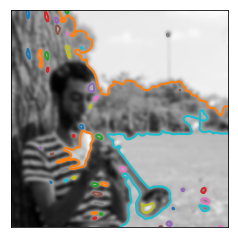

_____________________
sigma: 3.0, param: 0.5


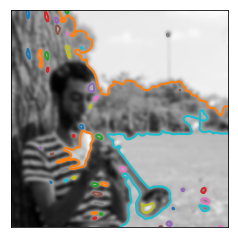

_____________________
sigma: 3.5, param: 0.5


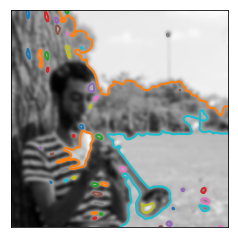

_____________________
sigma: 5.0, param: 0.5


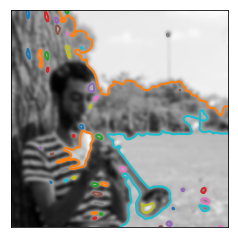

_____________________
sigma: 10.0, param: 0.5


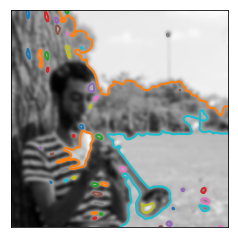

_____________________
sigma: 15.0, param: 0.5


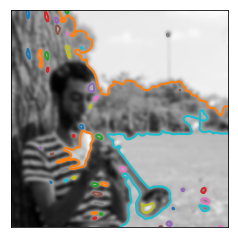

_____________________
sigma: 20.0, param: 0.5


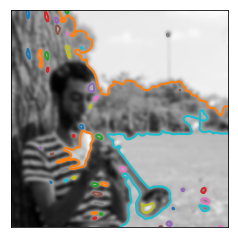

_____________________
sigma: 30.0, param: 0.5


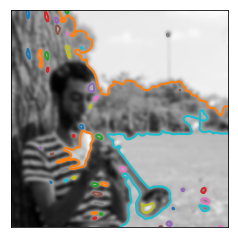

_____________________
sigma: 50.0, param: 0.5


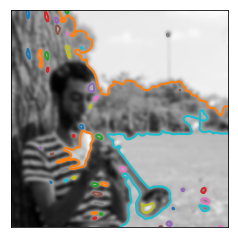

_____________________
sigma: 100.0, param: 0.5


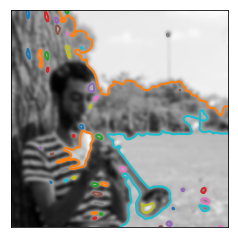

_____________________
sigma: 0.1, param: 0.6


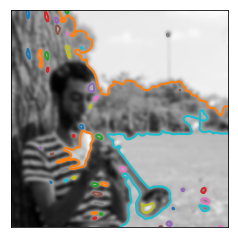

_____________________
sigma: 0.5, param: 0.6


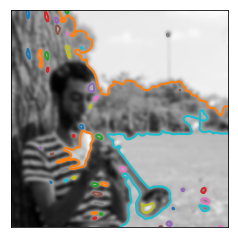

_____________________
sigma: 0.8, param: 0.6


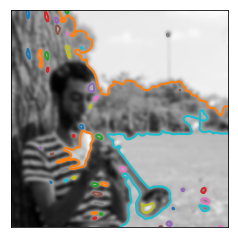

_____________________
sigma: 1.0, param: 0.6


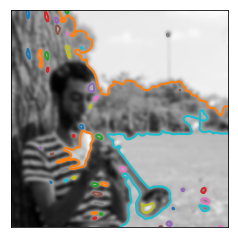

_____________________
sigma: 1.2, param: 0.6


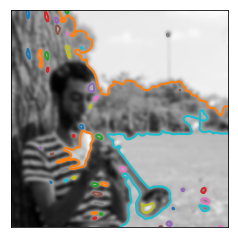

_____________________
sigma: 2.0, param: 0.6


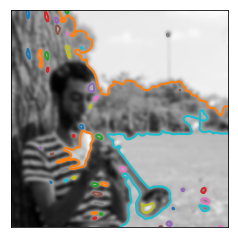

_____________________
sigma: 2.5, param: 0.6


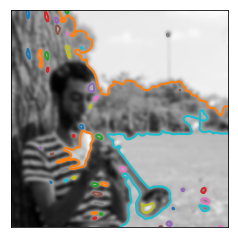

_____________________
sigma: 3.0, param: 0.6


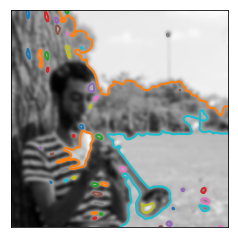

_____________________
sigma: 3.5, param: 0.6


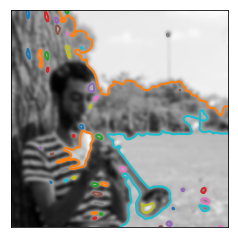

_____________________
sigma: 5.0, param: 0.6


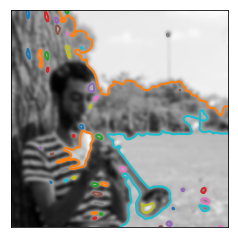

_____________________
sigma: 10.0, param: 0.6


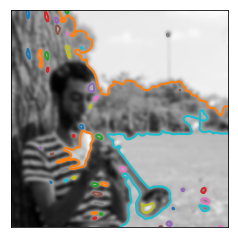

_____________________
sigma: 15.0, param: 0.6


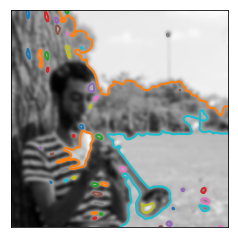

_____________________
sigma: 20.0, param: 0.6


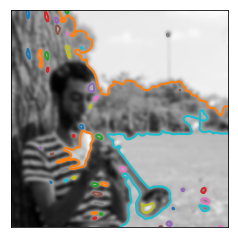

_____________________
sigma: 30.0, param: 0.6


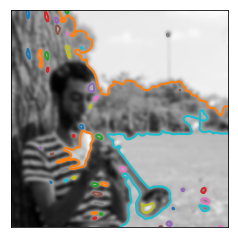

_____________________
sigma: 50.0, param: 0.6


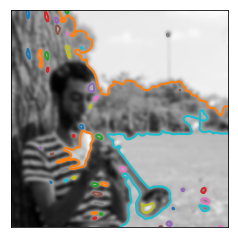

_____________________
sigma: 100.0, param: 0.6


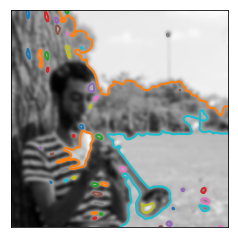

_____________________
sigma: 0.1, param: 0.7


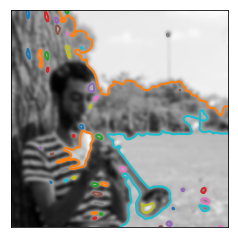

_____________________
sigma: 0.5, param: 0.7


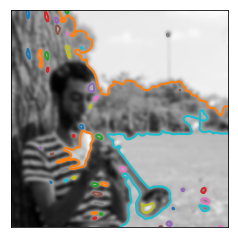

_____________________
sigma: 0.8, param: 0.7


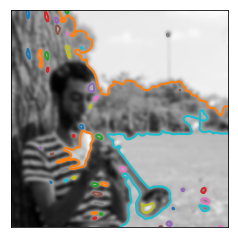

_____________________
sigma: 1.0, param: 0.7


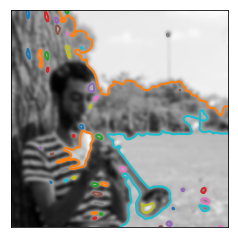

_____________________
sigma: 1.2, param: 0.7


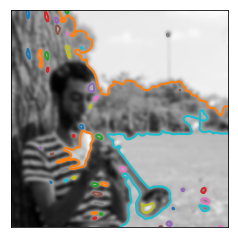

_____________________
sigma: 2.0, param: 0.7


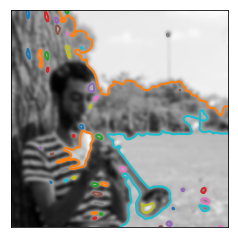

_____________________
sigma: 2.5, param: 0.7


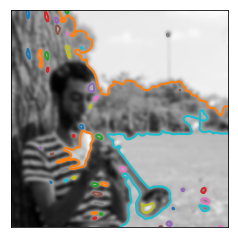

_____________________
sigma: 3.0, param: 0.7


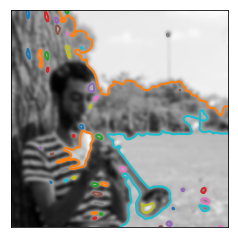

_____________________
sigma: 3.5, param: 0.7


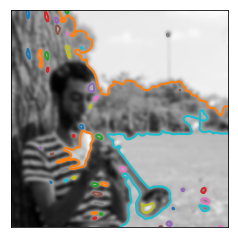

_____________________
sigma: 5.0, param: 0.7


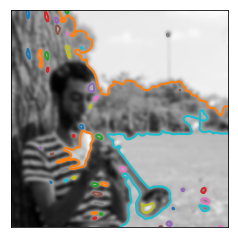

_____________________
sigma: 10.0, param: 0.7


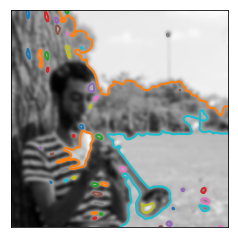

_____________________
sigma: 15.0, param: 0.7


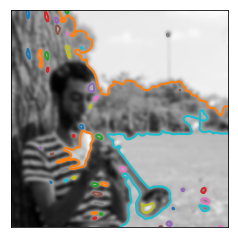

_____________________
sigma: 20.0, param: 0.7


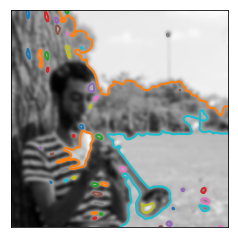

_____________________
sigma: 30.0, param: 0.7


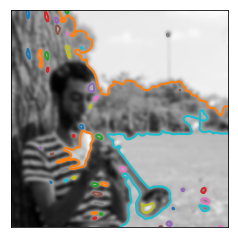

_____________________
sigma: 50.0, param: 0.7


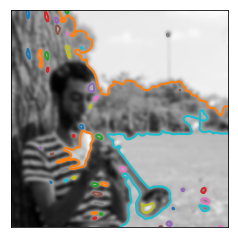

_____________________
sigma: 100.0, param: 0.7


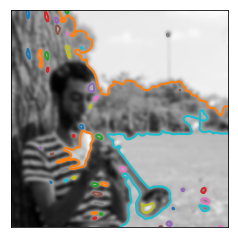

_____________________
sigma: 0.1, param: 0.8


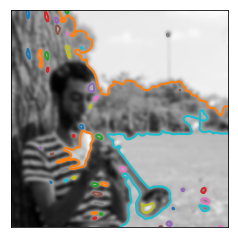

_____________________
sigma: 0.5, param: 0.8


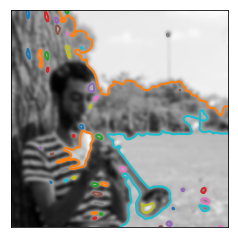

_____________________
sigma: 0.8, param: 0.8


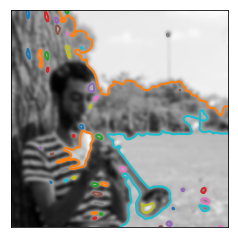

_____________________
sigma: 1.0, param: 0.8


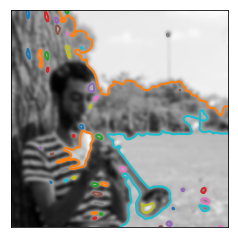

_____________________
sigma: 1.2, param: 0.8


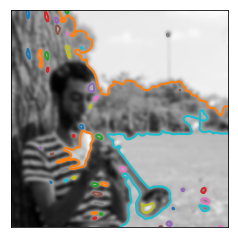

_____________________
sigma: 2.0, param: 0.8


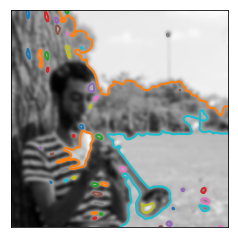

_____________________
sigma: 2.5, param: 0.8


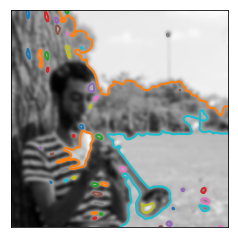

_____________________
sigma: 3.0, param: 0.8


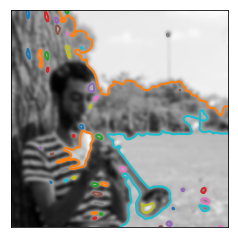

_____________________
sigma: 3.5, param: 0.8


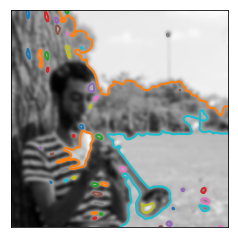

_____________________
sigma: 5.0, param: 0.8


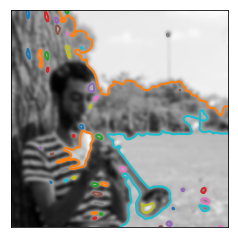

_____________________
sigma: 10.0, param: 0.8


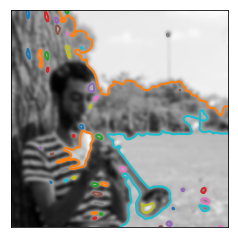

_____________________
sigma: 15.0, param: 0.8


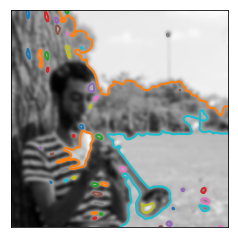

_____________________
sigma: 20.0, param: 0.8


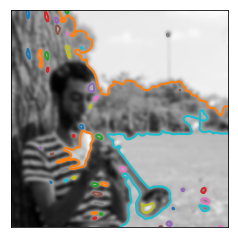

_____________________
sigma: 30.0, param: 0.8


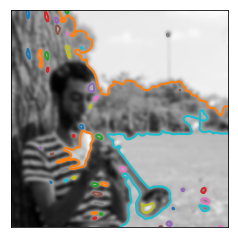

_____________________
sigma: 50.0, param: 0.8


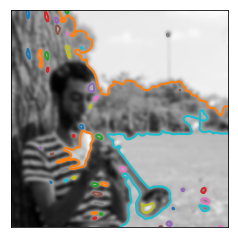

_____________________
sigma: 100.0, param: 0.8


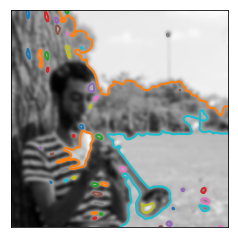

_____________________
sigma: 0.1, param: 0.9


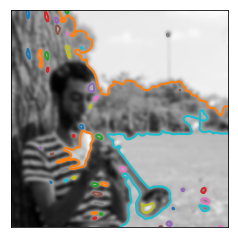

_____________________
sigma: 0.5, param: 0.9


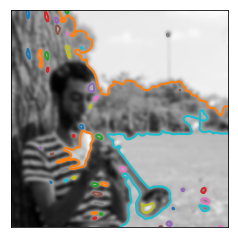

_____________________
sigma: 0.8, param: 0.9


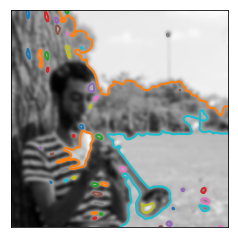

_____________________
sigma: 1.0, param: 0.9


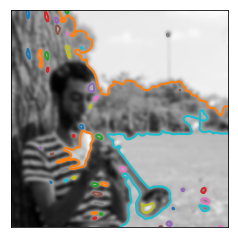

_____________________
sigma: 1.2, param: 0.9


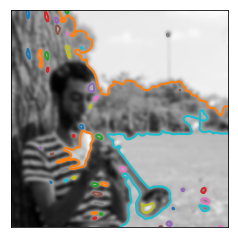

_____________________
sigma: 2.0, param: 0.9


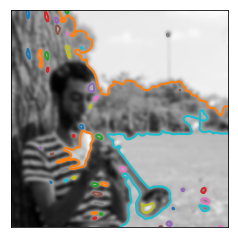

_____________________
sigma: 2.5, param: 0.9


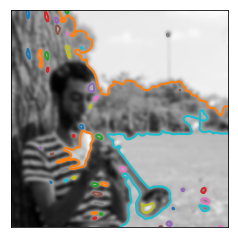

_____________________
sigma: 3.0, param: 0.9


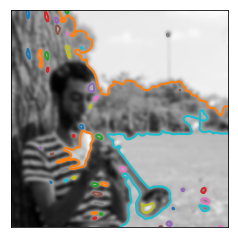

_____________________
sigma: 3.5, param: 0.9


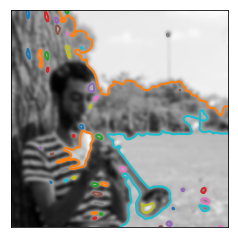

_____________________
sigma: 5.0, param: 0.9


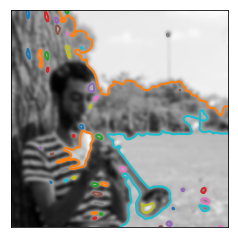

_____________________
sigma: 10.0, param: 0.9


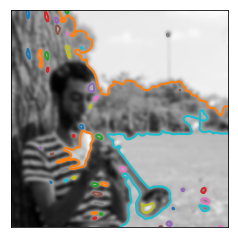

_____________________
sigma: 15.0, param: 0.9


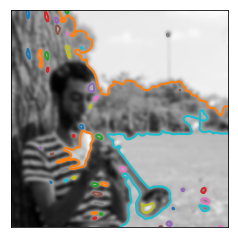

_____________________
sigma: 20.0, param: 0.9


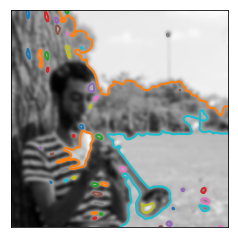

_____________________
sigma: 30.0, param: 0.9


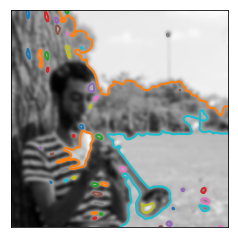

_____________________
sigma: 50.0, param: 0.9


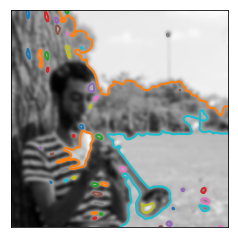

_____________________
sigma: 100.0, param: 0.9


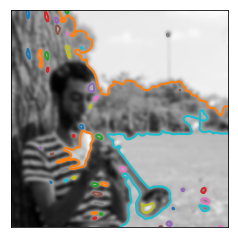

_____________________
sigma: 0.1, param: 0.99


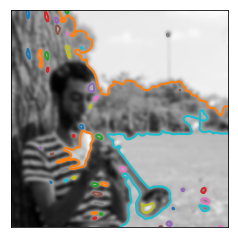

_____________________
sigma: 0.5, param: 0.99


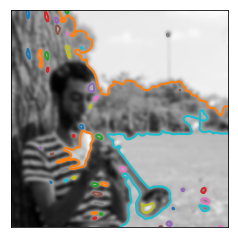

_____________________
sigma: 0.8, param: 0.99


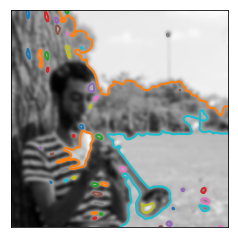

_____________________
sigma: 1.0, param: 0.99


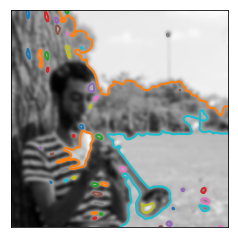

_____________________
sigma: 1.2, param: 0.99


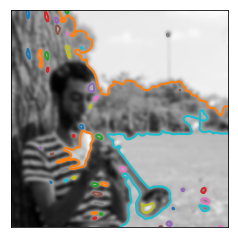

_____________________
sigma: 2.0, param: 0.99


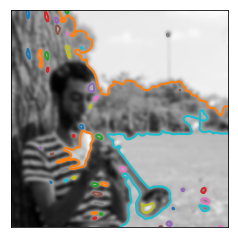

_____________________
sigma: 2.5, param: 0.99


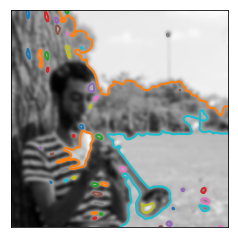

_____________________
sigma: 3.0, param: 0.99


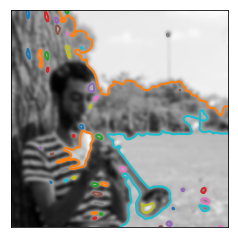

_____________________
sigma: 3.5, param: 0.99


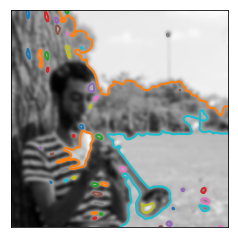

_____________________
sigma: 5.0, param: 0.99


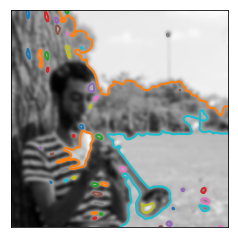

_____________________
sigma: 10.0, param: 0.99


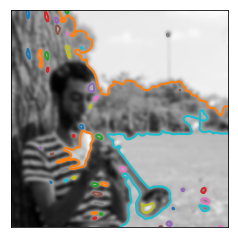

_____________________
sigma: 15.0, param: 0.99


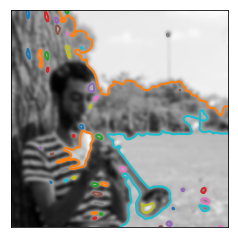

_____________________
sigma: 20.0, param: 0.99


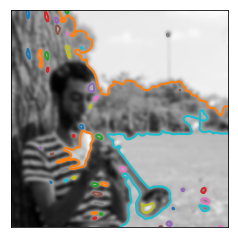

_____________________
sigma: 30.0, param: 0.99


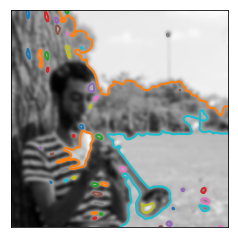

_____________________
sigma: 50.0, param: 0.99


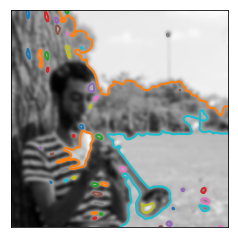

_____________________
sigma: 100.0, param: 0.99


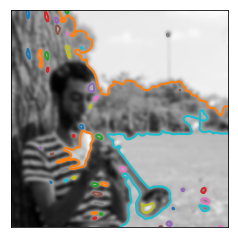

_____________________
sigma: 0.1, param: 0.999


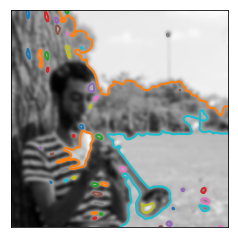

_____________________
sigma: 0.5, param: 0.999


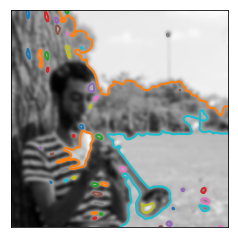

_____________________
sigma: 0.8, param: 0.999


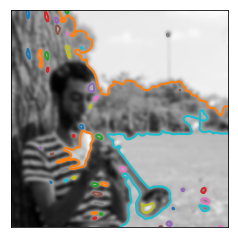

_____________________
sigma: 1.0, param: 0.999


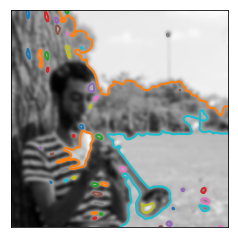

_____________________
sigma: 1.2, param: 0.999


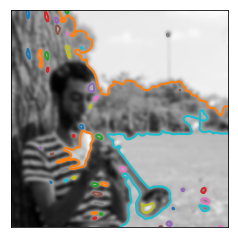

_____________________
sigma: 2.0, param: 0.999


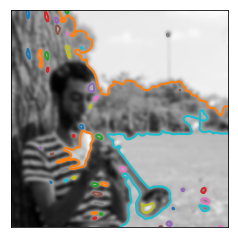

_____________________
sigma: 2.5, param: 0.999


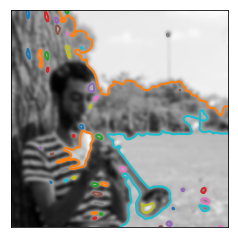

_____________________
sigma: 3.0, param: 0.999


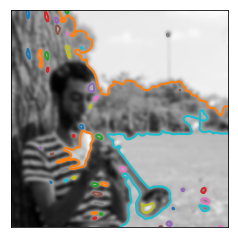

_____________________
sigma: 3.5, param: 0.999


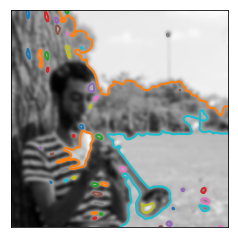

_____________________
sigma: 5.0, param: 0.999


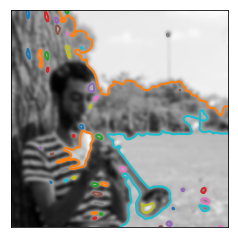

_____________________
sigma: 10.0, param: 0.999


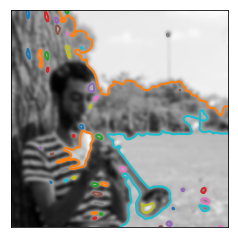

_____________________
sigma: 15.0, param: 0.999


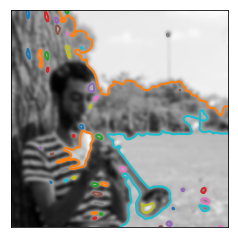

_____________________
sigma: 20.0, param: 0.999


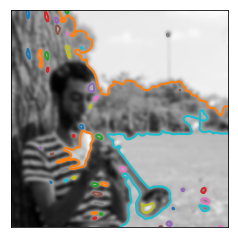

_____________________
sigma: 30.0, param: 0.999


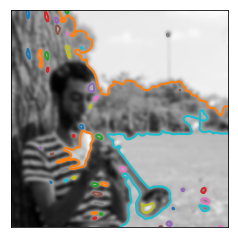

_____________________
sigma: 50.0, param: 0.999


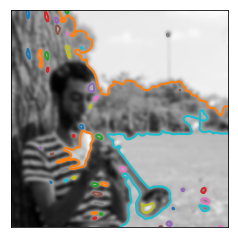

_____________________
sigma: 100.0, param: 0.999


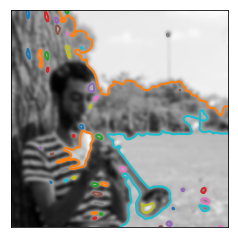

_____________________
sigma: 0.1, param: 1.0


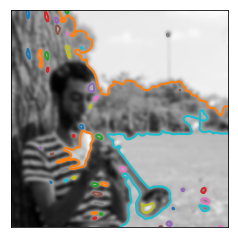

_____________________
sigma: 0.5, param: 1.0


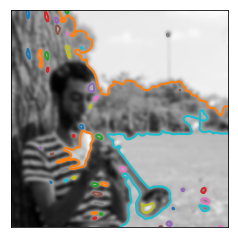

_____________________
sigma: 0.8, param: 1.0


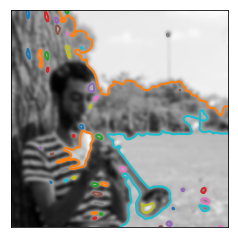

_____________________
sigma: 1.0, param: 1.0


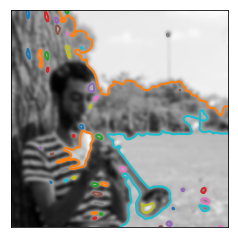

_____________________
sigma: 1.2, param: 1.0


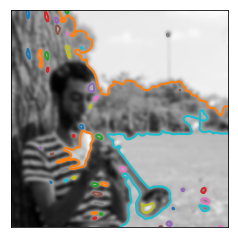

_____________________
sigma: 2.0, param: 1.0


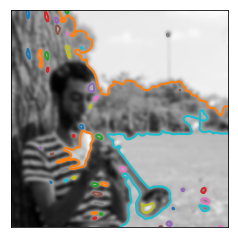

_____________________
sigma: 2.5, param: 1.0


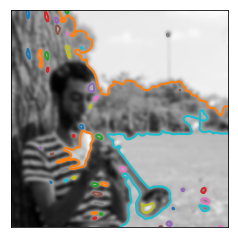

_____________________
sigma: 3.0, param: 1.0


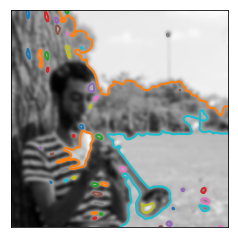

_____________________
sigma: 3.5, param: 1.0


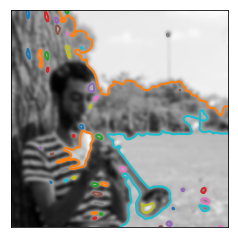

_____________________
sigma: 5.0, param: 1.0


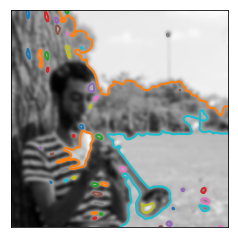

_____________________
sigma: 10.0, param: 1.0


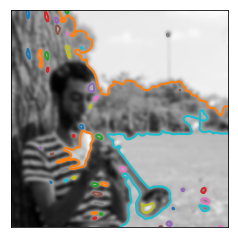

_____________________
sigma: 15.0, param: 1.0


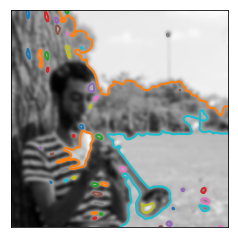

_____________________
sigma: 20.0, param: 1.0


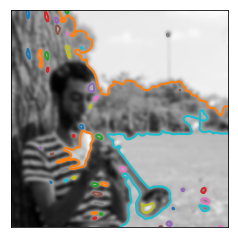

_____________________
sigma: 30.0, param: 1.0


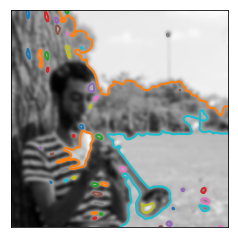

_____________________
sigma: 50.0, param: 1.0


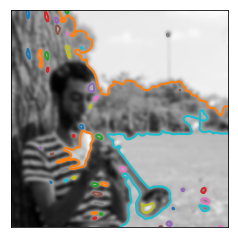

_____________________
sigma: 100.0, param: 1.0


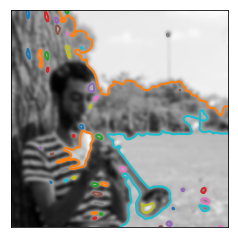

_____________________
sigma: 0.1, param: 1.1


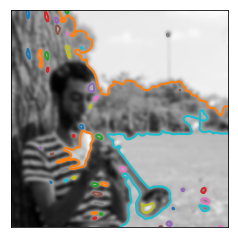

_____________________
sigma: 0.5, param: 1.1


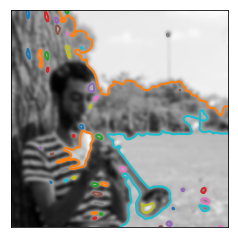

_____________________
sigma: 0.8, param: 1.1


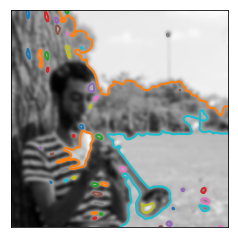

_____________________
sigma: 1.0, param: 1.1


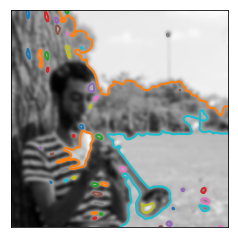

_____________________
sigma: 1.2, param: 1.1


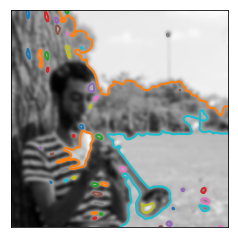

_____________________
sigma: 2.0, param: 1.1


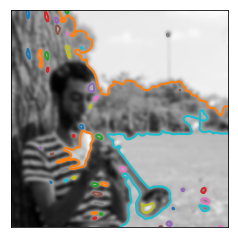

_____________________
sigma: 2.5, param: 1.1


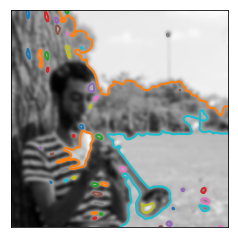

_____________________
sigma: 3.0, param: 1.1


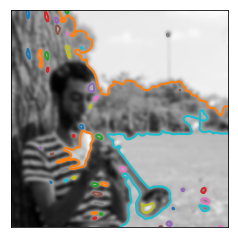

_____________________
sigma: 3.5, param: 1.1


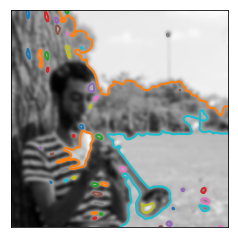

_____________________
sigma: 5.0, param: 1.1


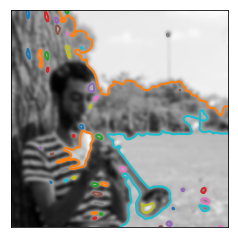

_____________________
sigma: 10.0, param: 1.1


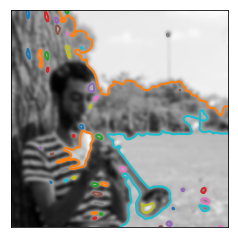

_____________________
sigma: 15.0, param: 1.1


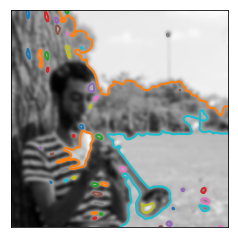

_____________________
sigma: 20.0, param: 1.1


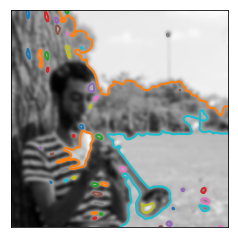

_____________________
sigma: 30.0, param: 1.1


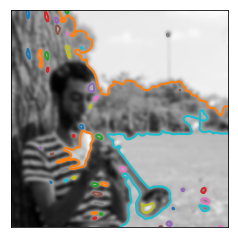

_____________________
sigma: 50.0, param: 1.1


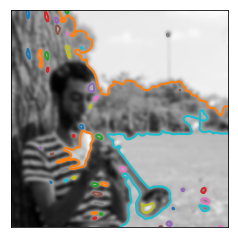

_____________________
sigma: 100.0, param: 1.1


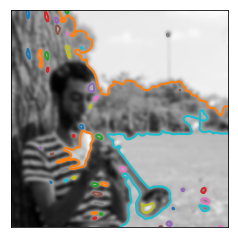

_____________________
sigma: 0.1, param: 100.0


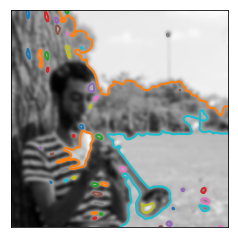

_____________________
sigma: 0.5, param: 100.0


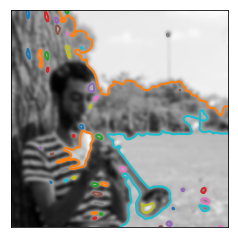

_____________________
sigma: 0.8, param: 100.0


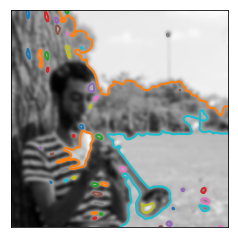

_____________________
sigma: 1.0, param: 100.0


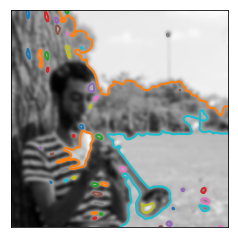

_____________________
sigma: 1.2, param: 100.0


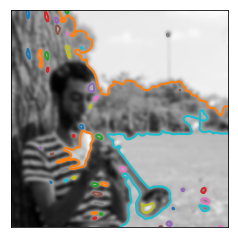

_____________________
sigma: 2.0, param: 100.0


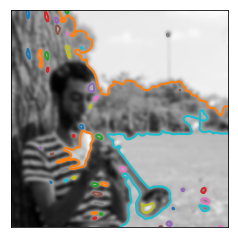

_____________________
sigma: 2.5, param: 100.0


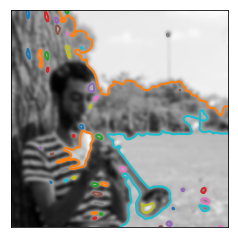

_____________________
sigma: 3.0, param: 100.0


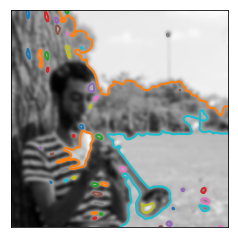

_____________________
sigma: 3.5, param: 100.0


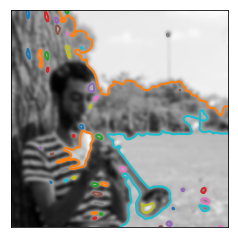

_____________________
sigma: 5.0, param: 100.0


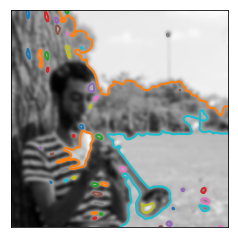

_____________________
sigma: 10.0, param: 100.0


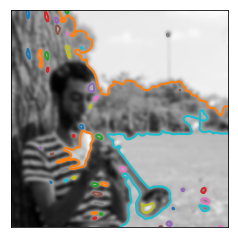

_____________________
sigma: 15.0, param: 100.0


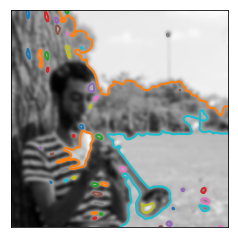

_____________________
sigma: 20.0, param: 100.0


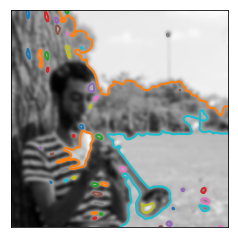

_____________________
sigma: 30.0, param: 100.0


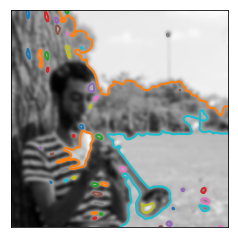

_____________________
sigma: 50.0, param: 100.0


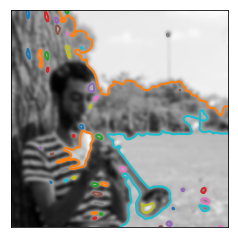

_____________________
sigma: 100.0, param: 100.0


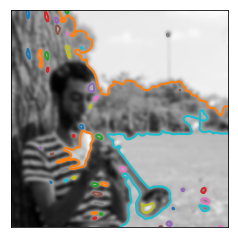

_____________________


In [78]:
for j in [0, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99, 0.999, 1.0, 1.1, 100]:
    for i in [0.1, 0.5, 0.8, 1, 1.2, 2, 2.5, 3, 3.5, 5, 10, 15, 20, 30, 50, 100]:
        contour_image(gray, float(i), float(j))

sigma: 0.1, param: 0.0


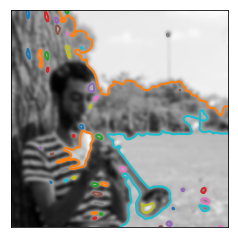

_____________________
sigma: 0.5, param: 0.0


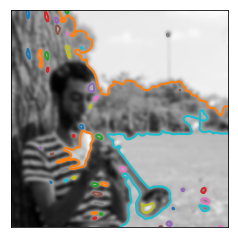

_____________________
sigma: 0.8, param: 0.0


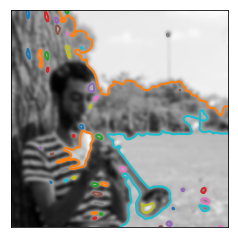

_____________________
sigma: 1.0, param: 0.0


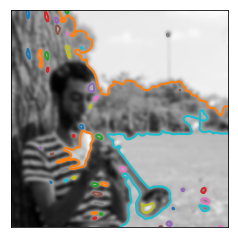

_____________________
sigma: 1.2, param: 0.0


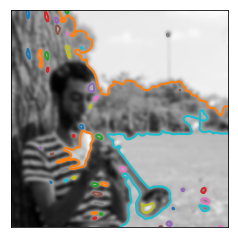

_____________________
sigma: 2.0, param: 0.0


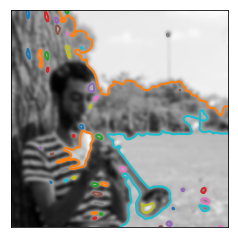

_____________________
sigma: 2.5, param: 0.0


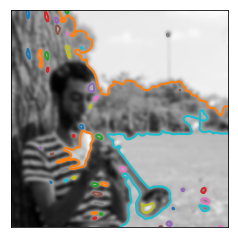

_____________________
sigma: 3.0, param: 0.0


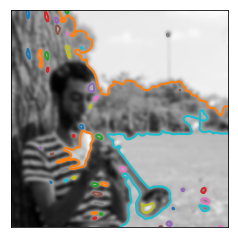

_____________________
sigma: 3.5, param: 0.0


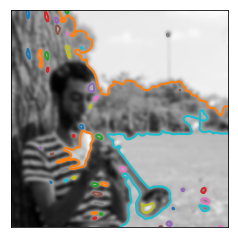

_____________________
sigma: 5.0, param: 0.0


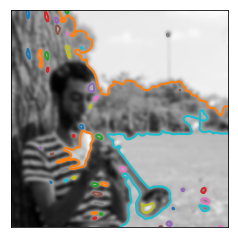

_____________________
sigma: 10.0, param: 0.0


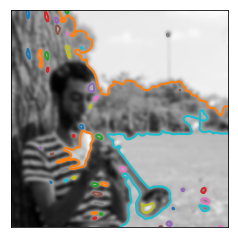

_____________________
sigma: 15.0, param: 0.0


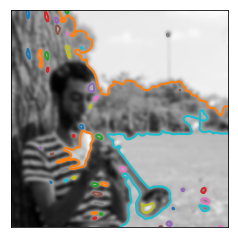

_____________________
sigma: 20.0, param: 0.0


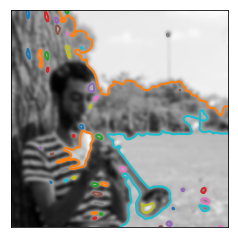

_____________________
sigma: 30.0, param: 0.0


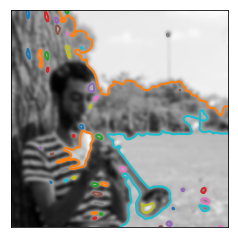

_____________________
sigma: 50.0, param: 0.0


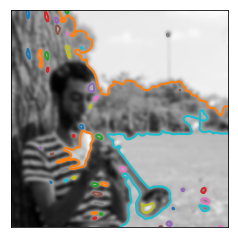

_____________________
sigma: 100.0, param: 0.0


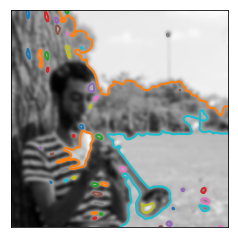

_____________________
sigma: 0.1, param: 0.1


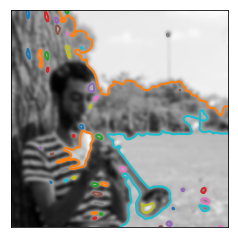

_____________________
sigma: 0.5, param: 0.1


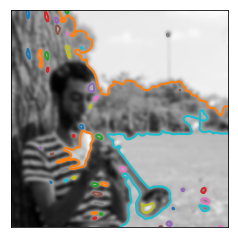

_____________________
sigma: 0.8, param: 0.1


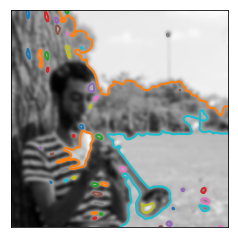

_____________________
sigma: 1.0, param: 0.1


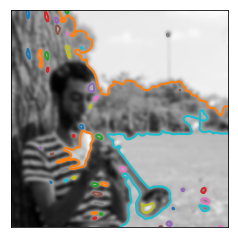

_____________________
sigma: 1.2, param: 0.1


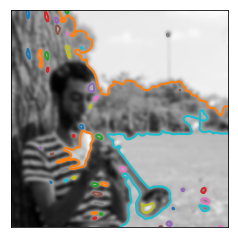

_____________________
sigma: 2.0, param: 0.1


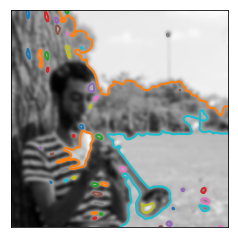

_____________________
sigma: 2.5, param: 0.1


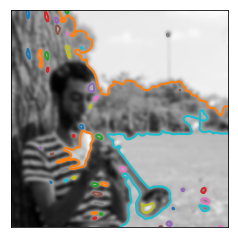

_____________________
sigma: 3.0, param: 0.1


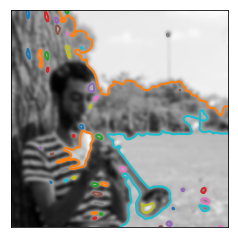

_____________________
sigma: 3.5, param: 0.1


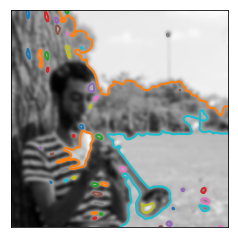

_____________________
sigma: 5.0, param: 0.1


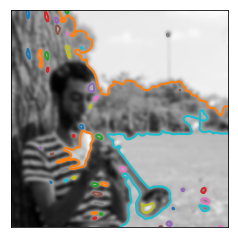

_____________________
sigma: 10.0, param: 0.1


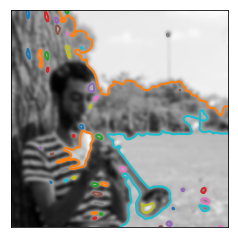

_____________________
sigma: 15.0, param: 0.1


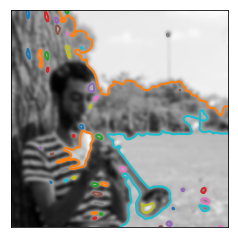

_____________________
sigma: 20.0, param: 0.1


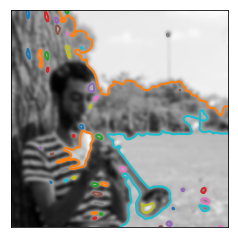

_____________________
sigma: 30.0, param: 0.1


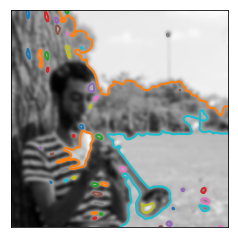

_____________________
sigma: 50.0, param: 0.1


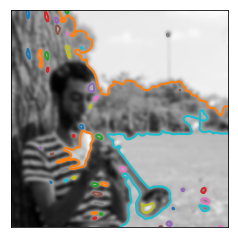

_____________________
sigma: 100.0, param: 0.1


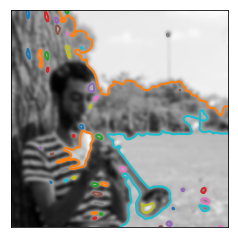

_____________________
sigma: 0.1, param: 0.2


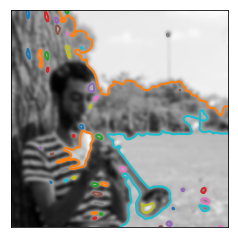

_____________________
sigma: 0.5, param: 0.2


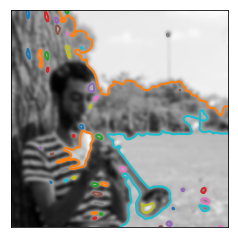

_____________________
sigma: 0.8, param: 0.2


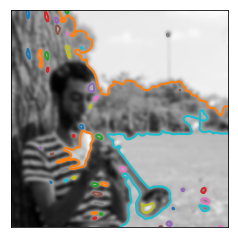

_____________________
sigma: 1.0, param: 0.2


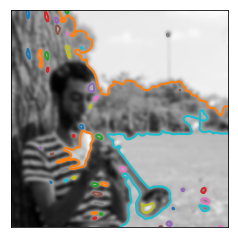

_____________________
sigma: 1.2, param: 0.2


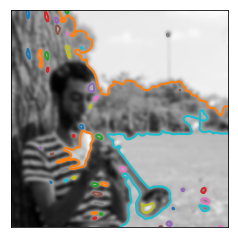

_____________________
sigma: 2.0, param: 0.2


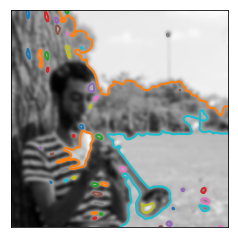

_____________________
sigma: 2.5, param: 0.2


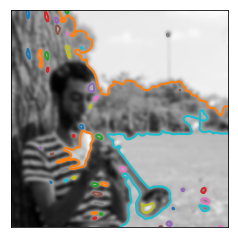

_____________________
sigma: 3.0, param: 0.2


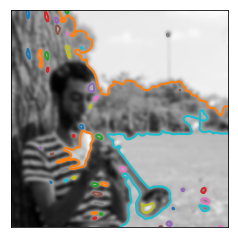

_____________________
sigma: 3.5, param: 0.2


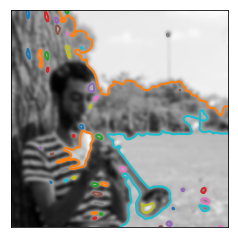

_____________________
sigma: 5.0, param: 0.2


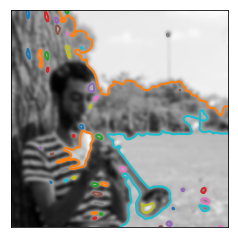

_____________________
sigma: 10.0, param: 0.2


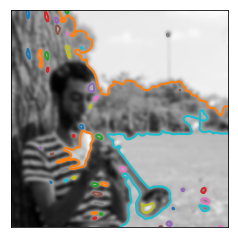

_____________________
sigma: 15.0, param: 0.2


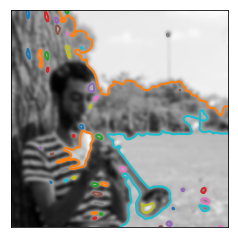

_____________________
sigma: 20.0, param: 0.2


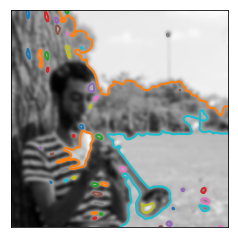

_____________________
sigma: 30.0, param: 0.2


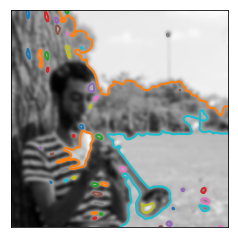

_____________________
sigma: 50.0, param: 0.2


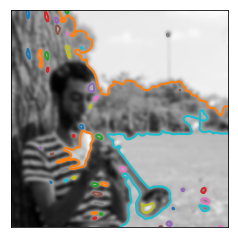

_____________________
sigma: 100.0, param: 0.2


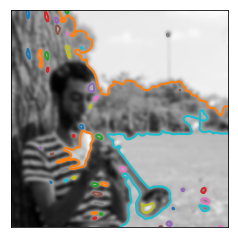

_____________________
sigma: 0.1, param: 0.3


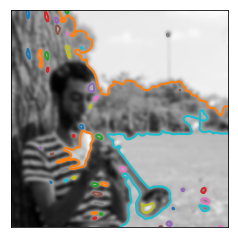

_____________________
sigma: 0.5, param: 0.3


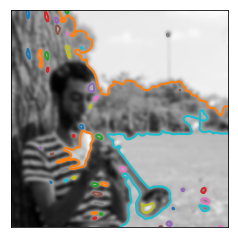

_____________________
sigma: 0.8, param: 0.3


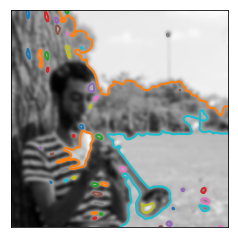

_____________________
sigma: 1.0, param: 0.3


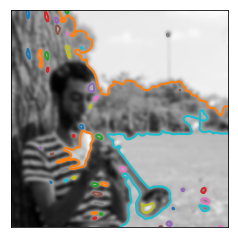

_____________________
sigma: 1.2, param: 0.3


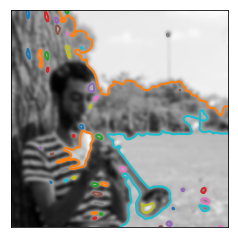

_____________________
sigma: 2.0, param: 0.3


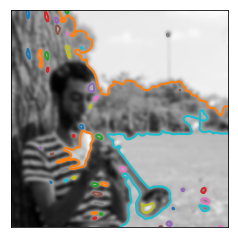

_____________________
sigma: 2.5, param: 0.3


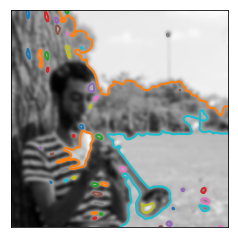

_____________________
sigma: 3.0, param: 0.3


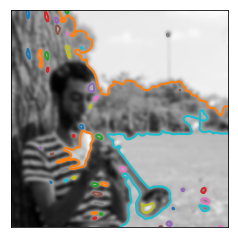

_____________________
sigma: 3.5, param: 0.3


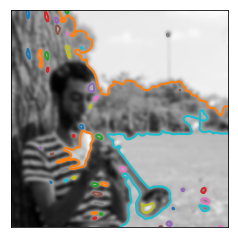

_____________________
sigma: 5.0, param: 0.3


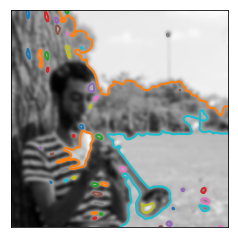

_____________________
sigma: 10.0, param: 0.3


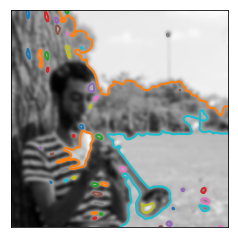

_____________________
sigma: 15.0, param: 0.3


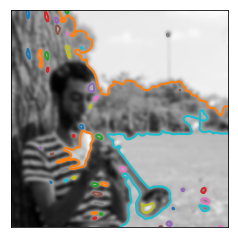

_____________________
sigma: 20.0, param: 0.3


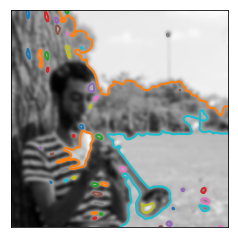

_____________________
sigma: 30.0, param: 0.3


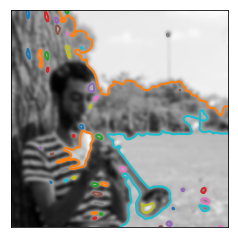

_____________________
sigma: 50.0, param: 0.3


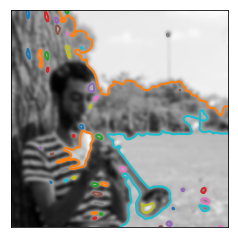

_____________________
sigma: 100.0, param: 0.3


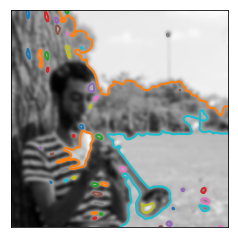

_____________________
sigma: 0.1, param: 0.5


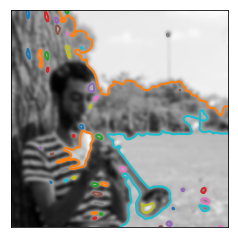

_____________________
sigma: 0.5, param: 0.5


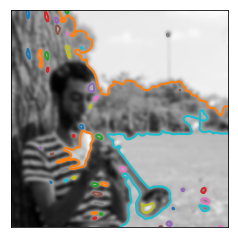

_____________________
sigma: 0.8, param: 0.5


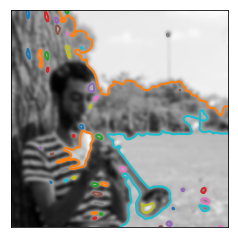

_____________________
sigma: 1.0, param: 0.5


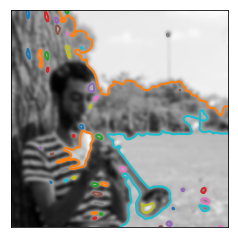

_____________________
sigma: 1.2, param: 0.5


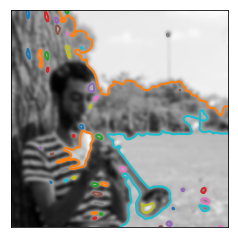

_____________________
sigma: 2.0, param: 0.5


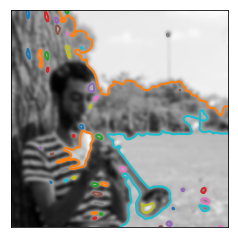

_____________________
sigma: 2.5, param: 0.5


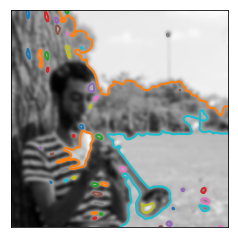

_____________________
sigma: 3.0, param: 0.5


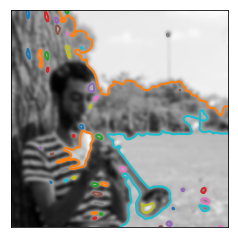

_____________________
sigma: 3.5, param: 0.5


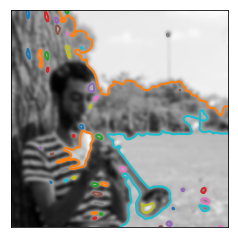

_____________________
sigma: 5.0, param: 0.5


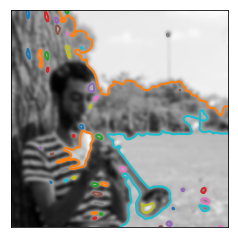

_____________________
sigma: 10.0, param: 0.5


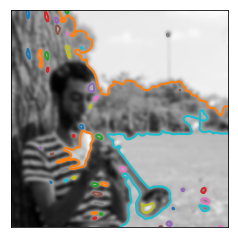

_____________________
sigma: 15.0, param: 0.5


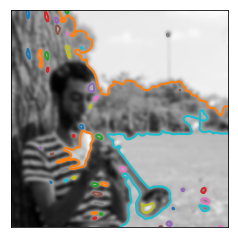

_____________________
sigma: 20.0, param: 0.5


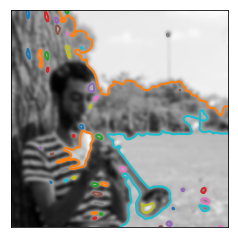

_____________________
sigma: 30.0, param: 0.5


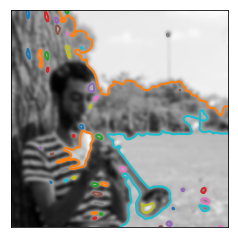

_____________________
sigma: 50.0, param: 0.5


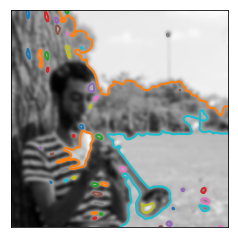

_____________________
sigma: 100.0, param: 0.5


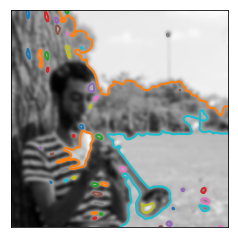

_____________________
sigma: 0.1, param: 0.6


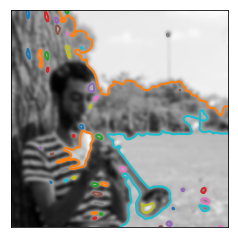

_____________________
sigma: 0.5, param: 0.6


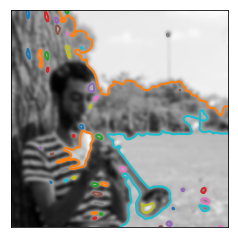

_____________________
sigma: 0.8, param: 0.6


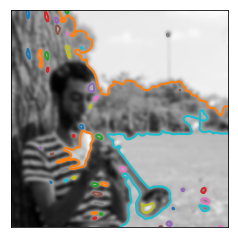

_____________________
sigma: 1.0, param: 0.6


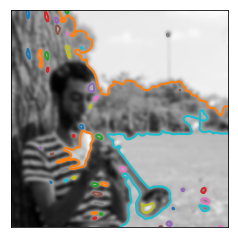

_____________________
sigma: 1.2, param: 0.6


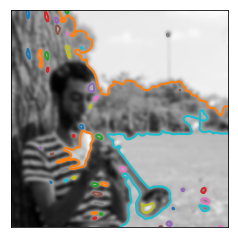

_____________________
sigma: 2.0, param: 0.6


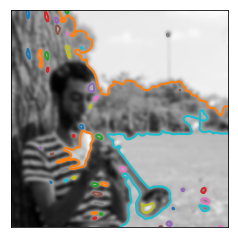

_____________________
sigma: 2.5, param: 0.6


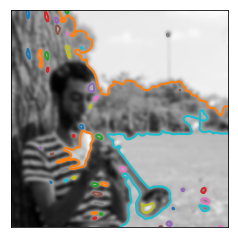

_____________________
sigma: 3.0, param: 0.6


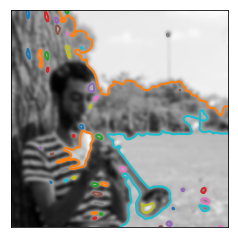

_____________________
sigma: 3.5, param: 0.6


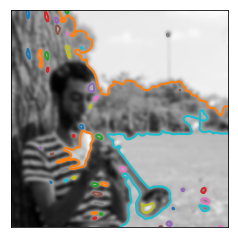

_____________________
sigma: 5.0, param: 0.6


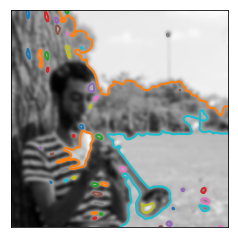

_____________________
sigma: 10.0, param: 0.6


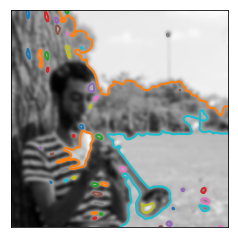

_____________________
sigma: 15.0, param: 0.6


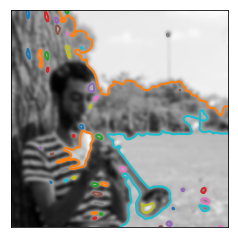

_____________________
sigma: 20.0, param: 0.6


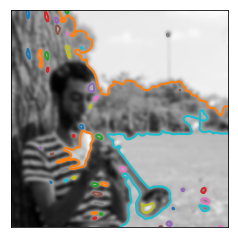

_____________________
sigma: 30.0, param: 0.6


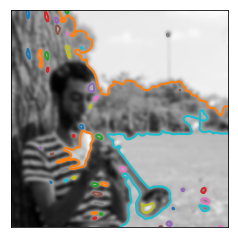

_____________________
sigma: 50.0, param: 0.6


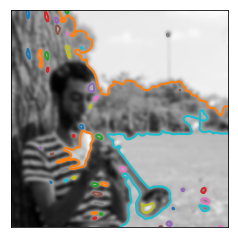

_____________________
sigma: 100.0, param: 0.6


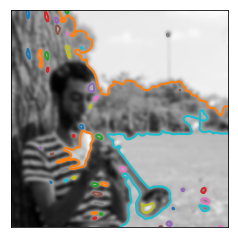

_____________________
sigma: 0.1, param: 0.7


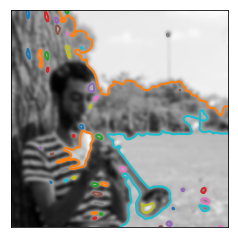

_____________________
sigma: 0.5, param: 0.7


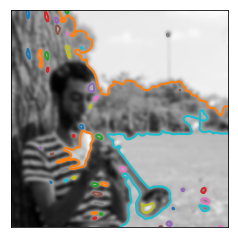

_____________________
sigma: 0.8, param: 0.7


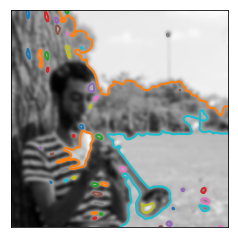

_____________________
sigma: 1.0, param: 0.7


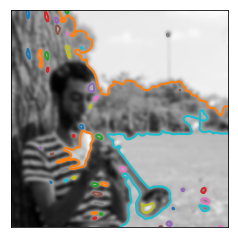

_____________________
sigma: 1.2, param: 0.7


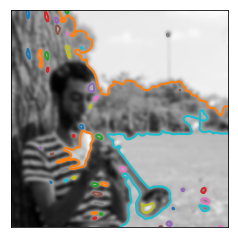

_____________________
sigma: 2.0, param: 0.7


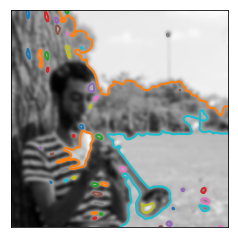

_____________________
sigma: 2.5, param: 0.7


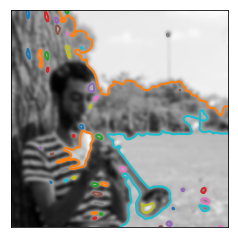

_____________________
sigma: 3.0, param: 0.7


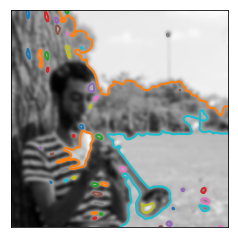

_____________________
sigma: 3.5, param: 0.7


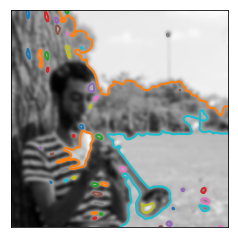

_____________________
sigma: 5.0, param: 0.7


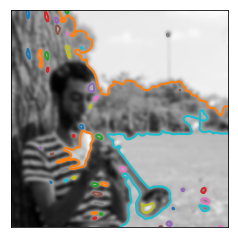

_____________________
sigma: 10.0, param: 0.7


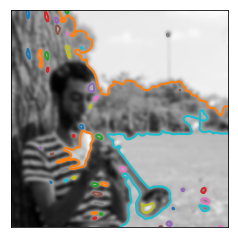

_____________________
sigma: 15.0, param: 0.7


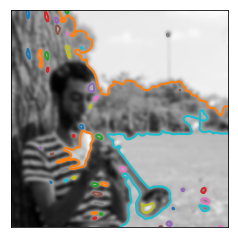

_____________________
sigma: 20.0, param: 0.7


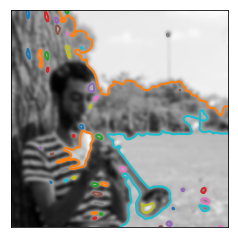

_____________________
sigma: 30.0, param: 0.7


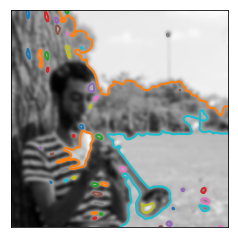

_____________________
sigma: 50.0, param: 0.7


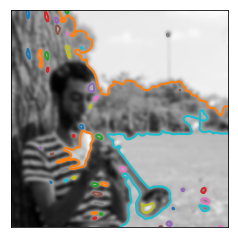

_____________________
sigma: 100.0, param: 0.7


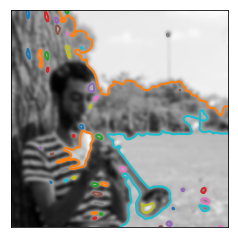

_____________________
sigma: 0.1, param: 0.8


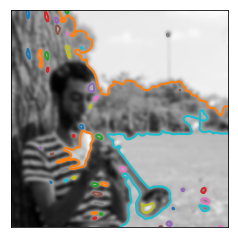

_____________________
sigma: 0.5, param: 0.8


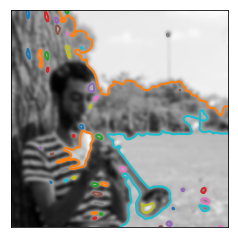

_____________________
sigma: 0.8, param: 0.8


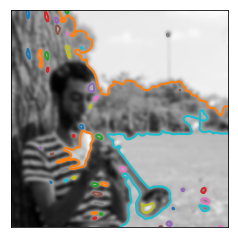

_____________________
sigma: 1.0, param: 0.8


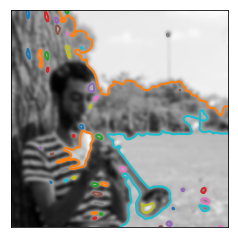

_____________________
sigma: 1.2, param: 0.8


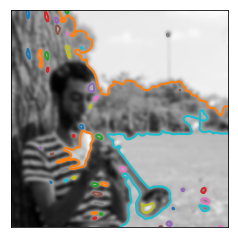

_____________________
sigma: 2.0, param: 0.8


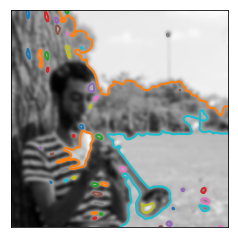

_____________________
sigma: 2.5, param: 0.8


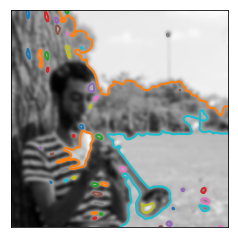

_____________________
sigma: 3.0, param: 0.8


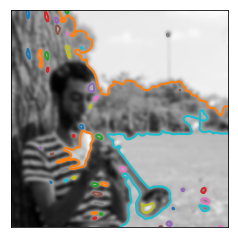

_____________________
sigma: 3.5, param: 0.8


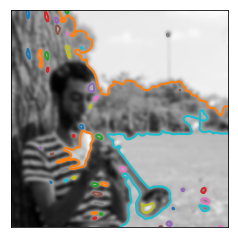

_____________________
sigma: 5.0, param: 0.8


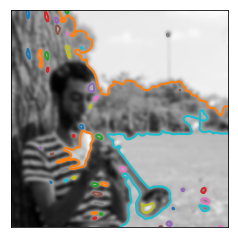

_____________________
sigma: 10.0, param: 0.8


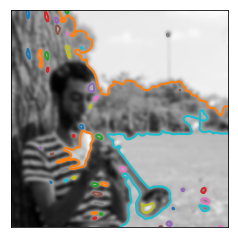

_____________________
sigma: 15.0, param: 0.8


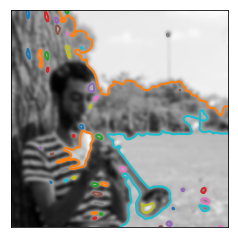

_____________________
sigma: 20.0, param: 0.8


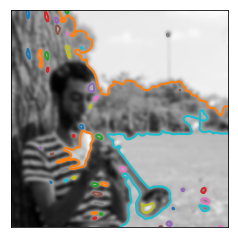

_____________________
sigma: 30.0, param: 0.8


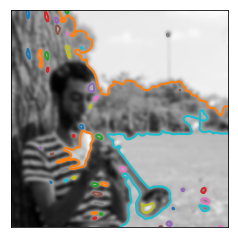

_____________________
sigma: 50.0, param: 0.8


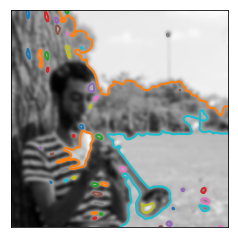

_____________________
sigma: 100.0, param: 0.8


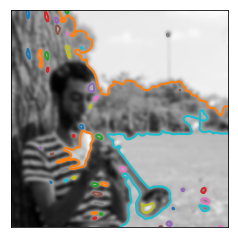

_____________________
sigma: 0.1, param: 0.9


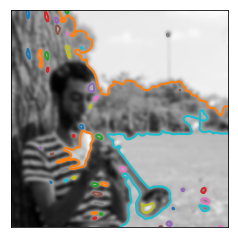

_____________________
sigma: 0.5, param: 0.9


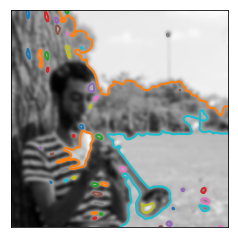

_____________________
sigma: 0.8, param: 0.9


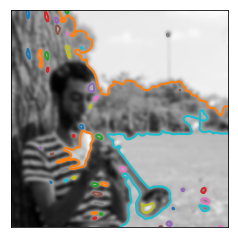

_____________________
sigma: 1.0, param: 0.9


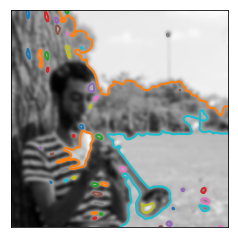

_____________________
sigma: 1.2, param: 0.9


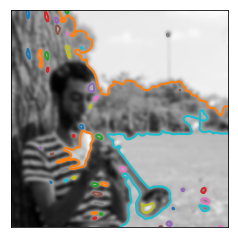

_____________________
sigma: 2.0, param: 0.9


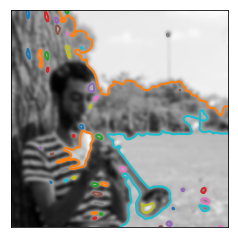

_____________________
sigma: 2.5, param: 0.9


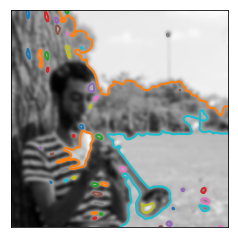

_____________________
sigma: 3.0, param: 0.9


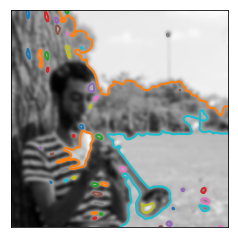

_____________________
sigma: 3.5, param: 0.9


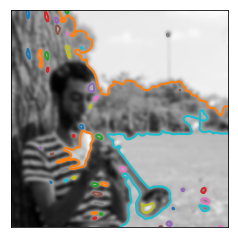

_____________________
sigma: 5.0, param: 0.9


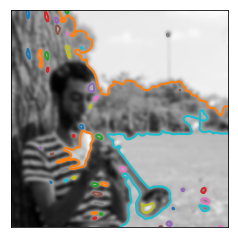

_____________________
sigma: 10.0, param: 0.9


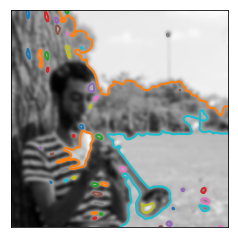

_____________________
sigma: 15.0, param: 0.9


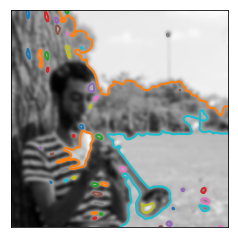

_____________________
sigma: 20.0, param: 0.9


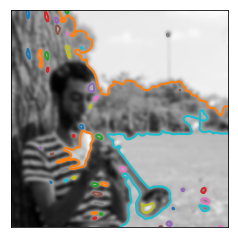

_____________________
sigma: 30.0, param: 0.9


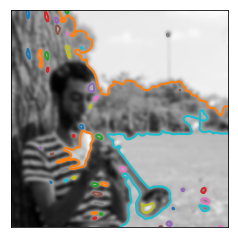

_____________________
sigma: 50.0, param: 0.9


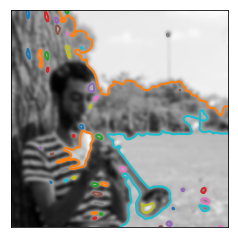

_____________________
sigma: 100.0, param: 0.9


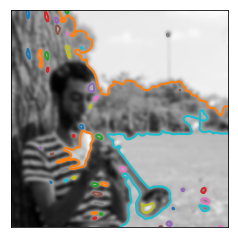

_____________________
sigma: 0.1, param: 0.99


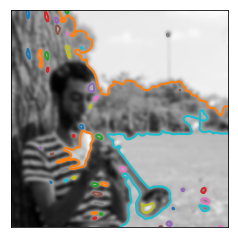

_____________________
sigma: 0.5, param: 0.99


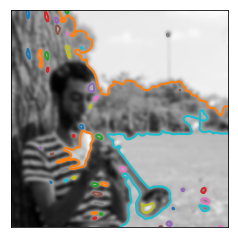

_____________________
sigma: 0.8, param: 0.99


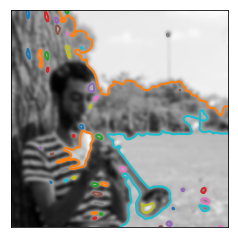

_____________________
sigma: 1.0, param: 0.99


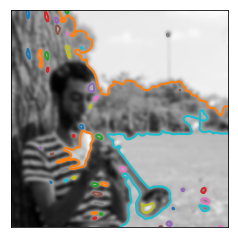

_____________________
sigma: 1.2, param: 0.99


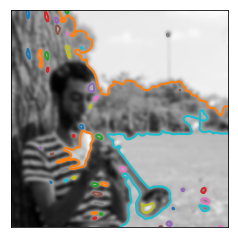

_____________________
sigma: 2.0, param: 0.99


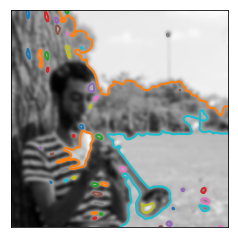

_____________________
sigma: 2.5, param: 0.99


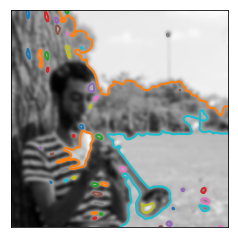

_____________________
sigma: 3.0, param: 0.99


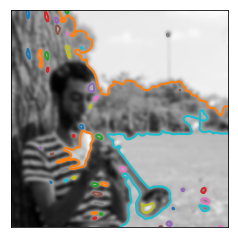

_____________________
sigma: 3.5, param: 0.99


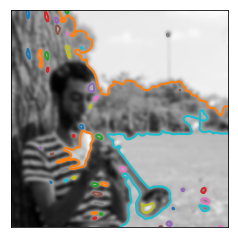

_____________________
sigma: 5.0, param: 0.99


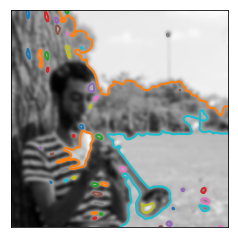

_____________________
sigma: 10.0, param: 0.99


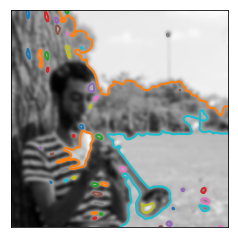

_____________________
sigma: 15.0, param: 0.99


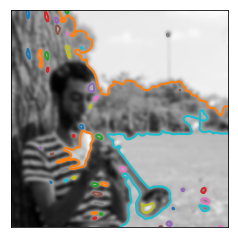

_____________________
sigma: 20.0, param: 0.99


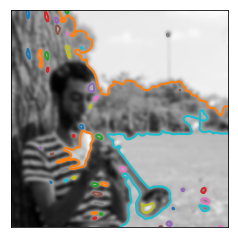

_____________________
sigma: 30.0, param: 0.99


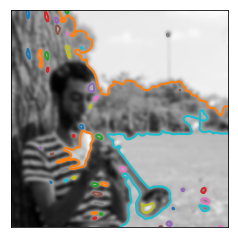

_____________________
sigma: 50.0, param: 0.99


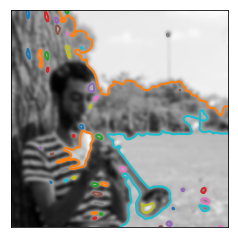

_____________________
sigma: 100.0, param: 0.99


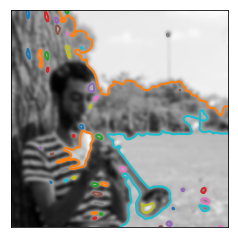

_____________________
sigma: 0.1, param: 0.999


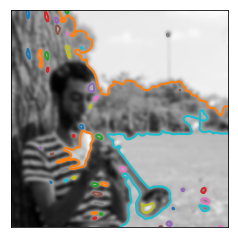

_____________________
sigma: 0.5, param: 0.999


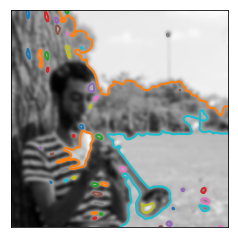

_____________________
sigma: 0.8, param: 0.999


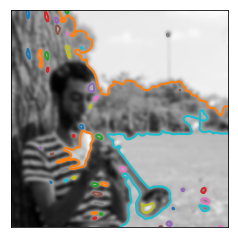

_____________________
sigma: 1.0, param: 0.999


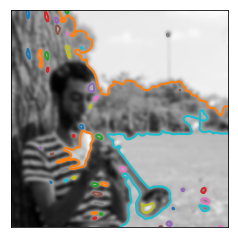

_____________________
sigma: 1.2, param: 0.999


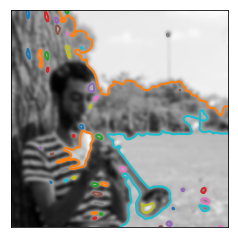

_____________________
sigma: 2.0, param: 0.999


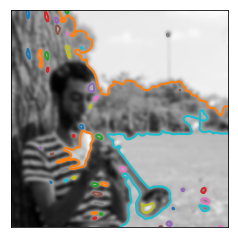

_____________________
sigma: 2.5, param: 0.999


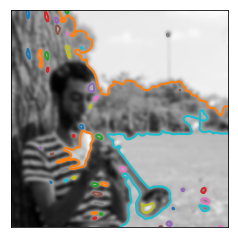

_____________________
sigma: 3.0, param: 0.999


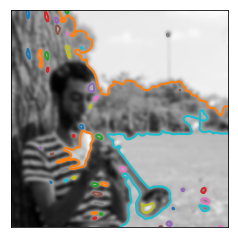

_____________________
sigma: 3.5, param: 0.999


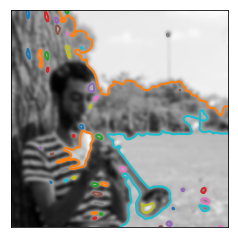

_____________________
sigma: 5.0, param: 0.999


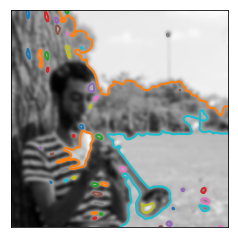

_____________________
sigma: 10.0, param: 0.999


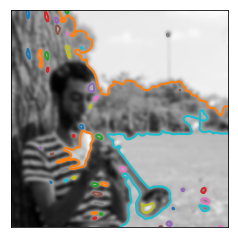

_____________________
sigma: 15.0, param: 0.999


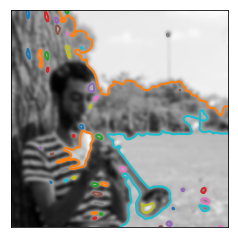

_____________________
sigma: 20.0, param: 0.999


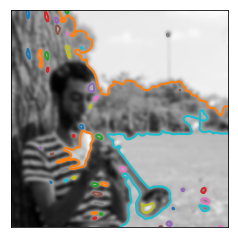

_____________________
sigma: 30.0, param: 0.999


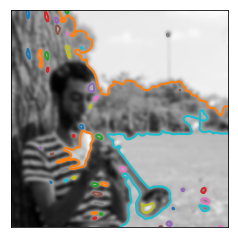

_____________________
sigma: 50.0, param: 0.999


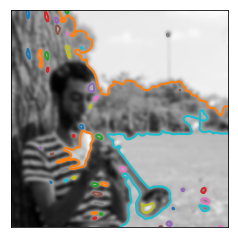

_____________________
sigma: 100.0, param: 0.999


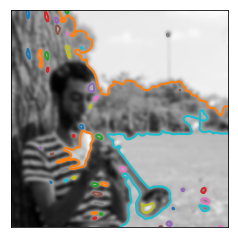

_____________________
sigma: 0.1, param: 1.0


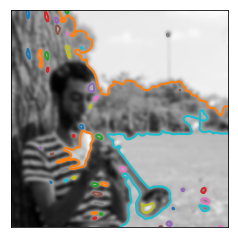

_____________________
sigma: 0.5, param: 1.0


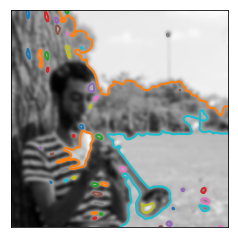

_____________________
sigma: 0.8, param: 1.0


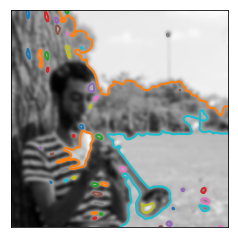

_____________________
sigma: 1.0, param: 1.0


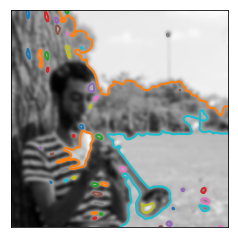

_____________________
sigma: 1.2, param: 1.0


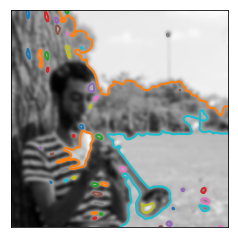

_____________________
sigma: 2.0, param: 1.0


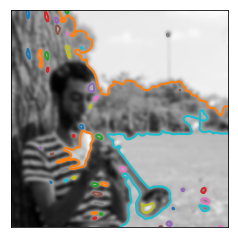

_____________________
sigma: 2.5, param: 1.0


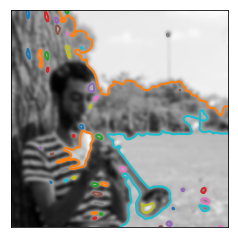

_____________________
sigma: 3.0, param: 1.0


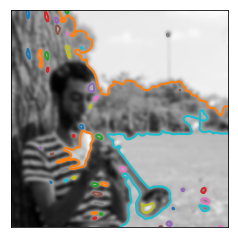

_____________________
sigma: 3.5, param: 1.0


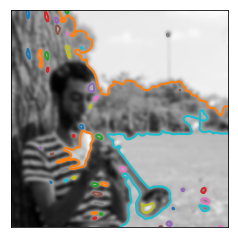

_____________________
sigma: 5.0, param: 1.0


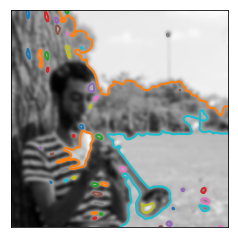

_____________________
sigma: 10.0, param: 1.0


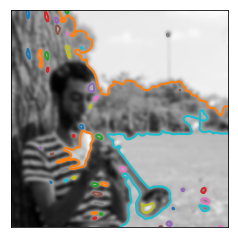

_____________________
sigma: 15.0, param: 1.0


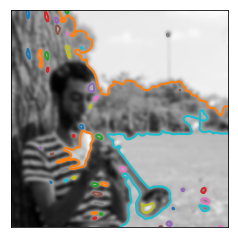

_____________________
sigma: 20.0, param: 1.0


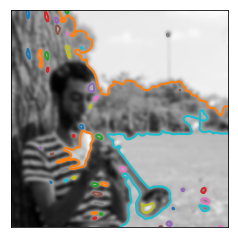

_____________________
sigma: 30.0, param: 1.0


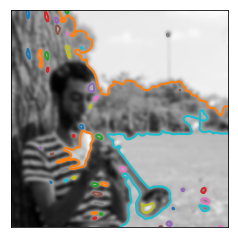

_____________________
sigma: 50.0, param: 1.0


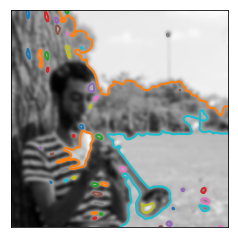

_____________________
sigma: 100.0, param: 1.0


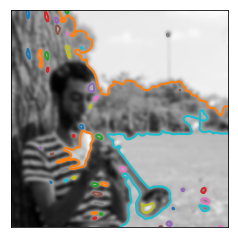

_____________________
sigma: 0.1, param: 1.1


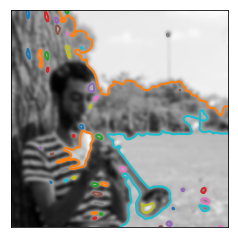

_____________________
sigma: 0.5, param: 1.1


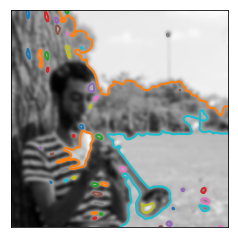

_____________________
sigma: 0.8, param: 1.1


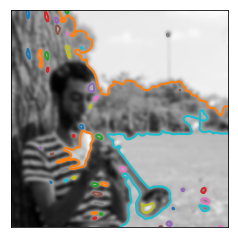

_____________________
sigma: 1.0, param: 1.1


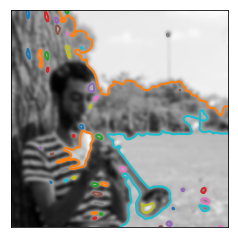

_____________________
sigma: 1.2, param: 1.1


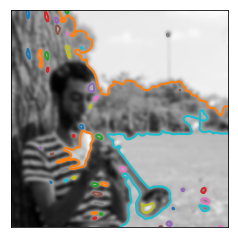

_____________________
sigma: 2.0, param: 1.1


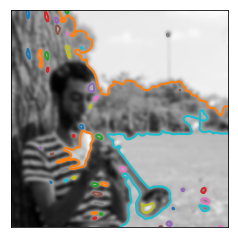

_____________________
sigma: 2.5, param: 1.1


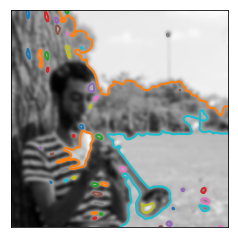

_____________________
sigma: 3.0, param: 1.1


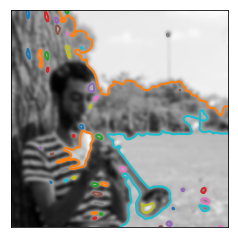

_____________________
sigma: 3.5, param: 1.1


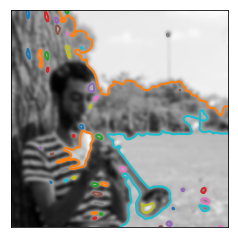

_____________________
sigma: 5.0, param: 1.1


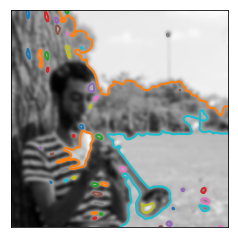

_____________________
sigma: 10.0, param: 1.1


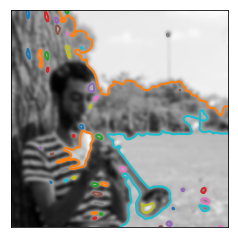

_____________________
sigma: 15.0, param: 1.1


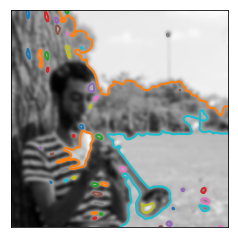

_____________________
sigma: 20.0, param: 1.1


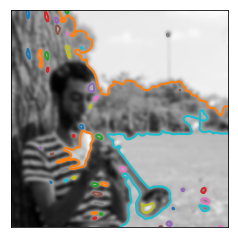

_____________________
sigma: 30.0, param: 1.1


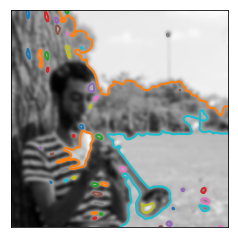

_____________________
sigma: 50.0, param: 1.1


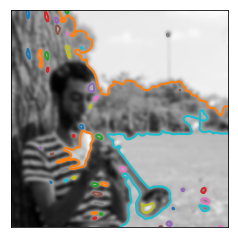

_____________________
sigma: 100.0, param: 1.1


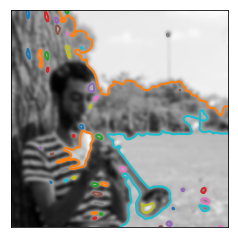

_____________________
sigma: 0.1, param: 100.0


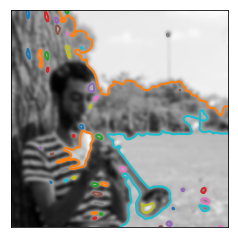

_____________________
sigma: 0.5, param: 100.0


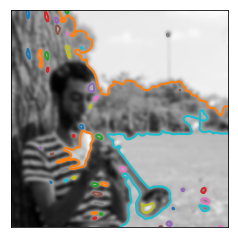

_____________________
sigma: 0.8, param: 100.0


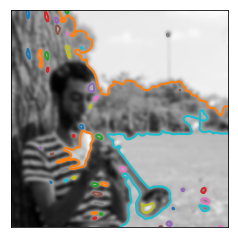

_____________________
sigma: 1.0, param: 100.0


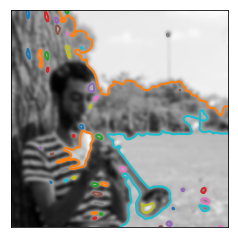

_____________________
sigma: 1.2, param: 100.0


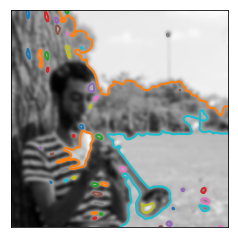

_____________________
sigma: 2.0, param: 100.0


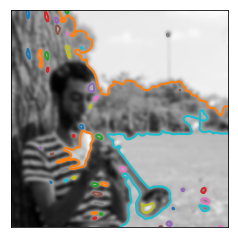

_____________________
sigma: 2.5, param: 100.0


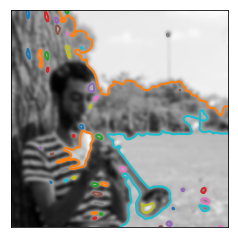

_____________________
sigma: 3.0, param: 100.0


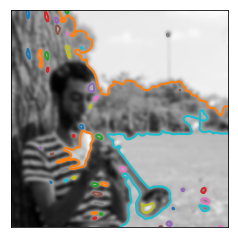

_____________________
sigma: 3.5, param: 100.0


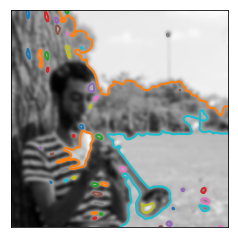

_____________________
sigma: 5.0, param: 100.0


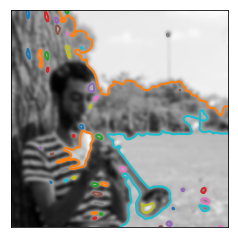

_____________________
sigma: 10.0, param: 100.0


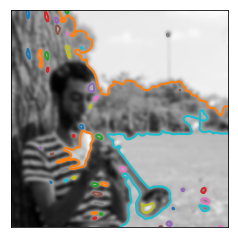

_____________________
sigma: 15.0, param: 100.0


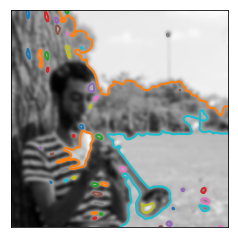

_____________________
sigma: 20.0, param: 100.0


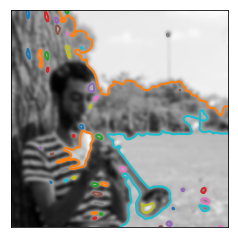

_____________________
sigma: 30.0, param: 100.0


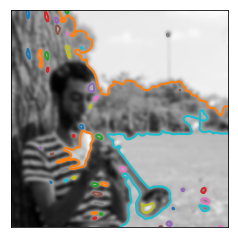

_____________________
sigma: 50.0, param: 100.0


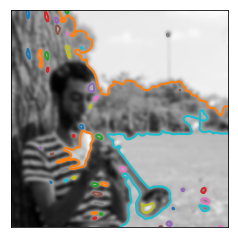

_____________________
sigma: 100.0, param: 100.0


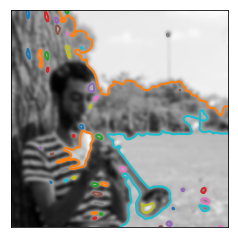

_____________________


In [80]:
for j in [0, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99, 0.999, 1.0, 1.1, 100]:
    for i in [0.1, 0.5, 0.8, 1, 1.2, 2, 2.5, 3, 3.5, 5, 10, 15, 20, 30, 50, 100]:
        contour_image(gray, float(i), float(j), 'low')

Good enough:

sigma: 1.0, param: 0.8


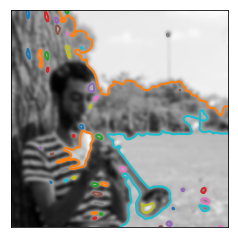

_____________________


In [81]:

contour_image(gray, 1.0, 0.8, 'low')

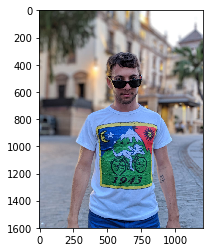

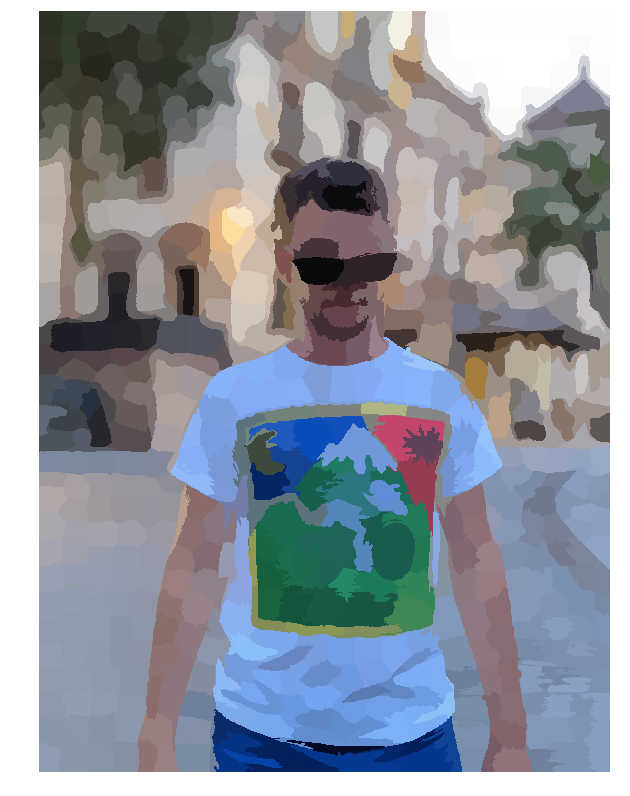

In [87]:
image = io.imread('pato.jpeg')
plt.imshow(image);
image_slic = seg.slic(image,n_segments=750)
image_show(color.label2rgb(image_slic, image, kind='avg'));

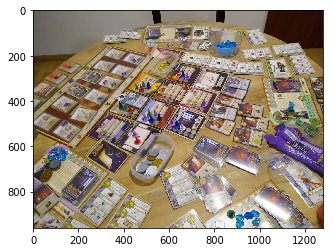

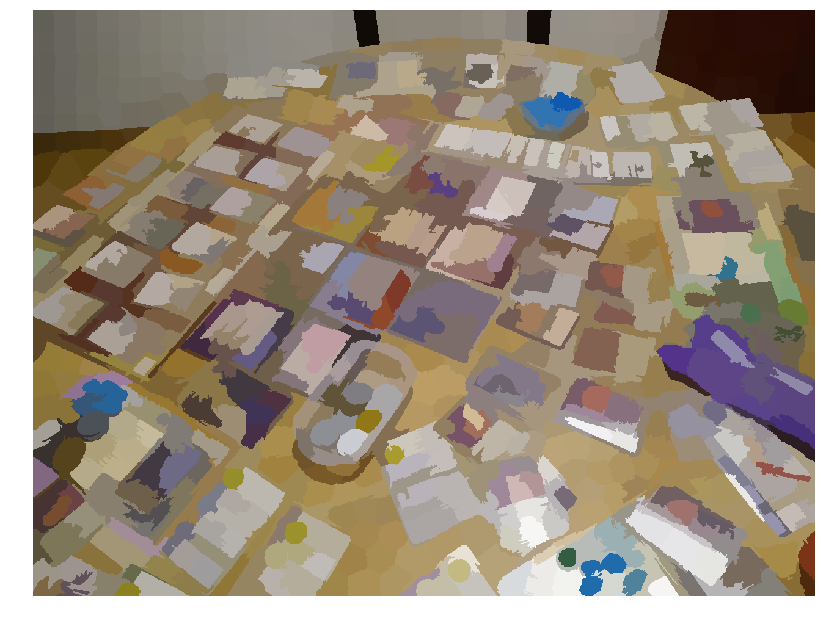

In [90]:
image = io.imread('argent.jpeg')
plt.imshow(image);
image_slic = seg.slic(image,n_segments=1000)
image_show(color.label2rgb(image_slic, image, kind='avg'));

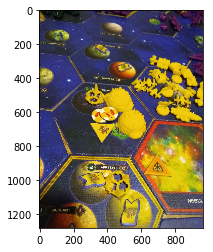

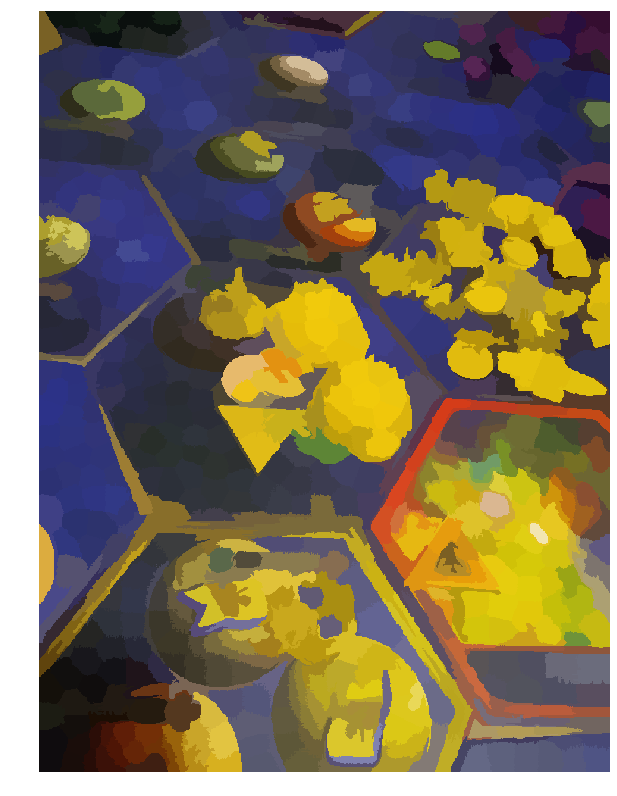

In [91]:
image = io.imread('ti.jpeg')
plt.imshow(image);
image_slic = seg.slic(image,n_segments=1000)
image_show(color.label2rgb(image_slic, image, kind='avg'));

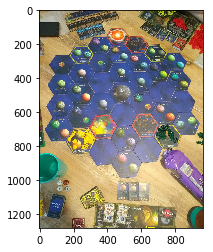

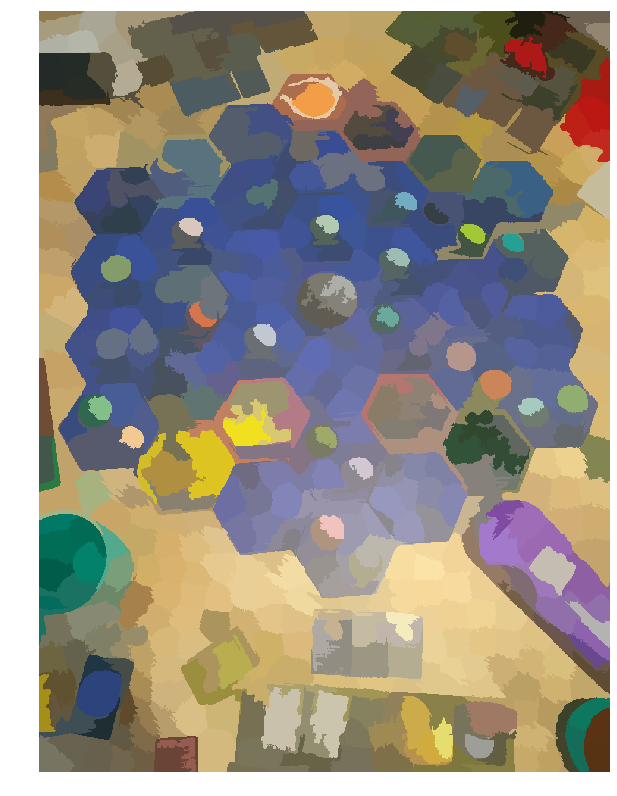

In [93]:
image = io.imread('ti2.jpeg')
plt.imshow(image);
image_slic = seg.slic(image,n_segments=750)
image_show(color.label2rgb(image_slic, image, kind='avg'));